In [1]:
DIR="/home/chenzh/My_project/SHI_Glu"
TD="Aug_2022"
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:90% !important; }</style>"))
%matplotlib inline
import scvelo as scv
import scanpy as sc
import os
import numpy as np
import pandas as pd
from matplotlib import rcParams
import matplotlib.pyplot as plt
scv.settings.verbosity = 3  # show errors(0), warnings(1), info(2), hints(3)
scv.settings.set_figure_params('scvelo',dpi_save=300)  # for beautified visualization
#plt.rcParams['pdf.fonttype'] = 'truetype'
p_col_set={"Fib_SC1":"#4EA74A","Fib_SC2":"#8E4B99","Fib_SC3":"#E88F14","Fib_SC4":"#E57FB0","Fib_SC5":"#B699C6","Fib_SC6":"#A15428","Fib_SC7":"#55A7D6","Fib_SC8":"#202D70"}
scv.set_figure_params()
scv.settings.set_figure_params('scvelo')  #


In [2]:
os.chdir(DIR)

Only considering the two last: ['.only', '.h5ad'].
Only considering the two last: ['.only', '.h5ad'].


(4929, 2)

In [53]:
adata = scv.read("/home/chenzh/My_project/SHI_Glu/tmp_data/Aug_2022/Vel/Sample_M.fibro.only.h5ad")
adata.obsm['X_umap']=adata.obs[["UMAP_1","UMAP_2"]].to_numpy()
adata.obsm['X_umap'].shape
# subset the fibroblast data


array([[-4.14309892, -3.44856733],
       [-7.39892557, -1.95504862],
       [ 2.99901983, -2.04572106],
       ...,
       [-0.40797451, -0.06535   ],
       [-3.61071926, -3.4865169 ],
       [ 0.26778957,  1.7369464 ]])

... storing 'sample' as categorical
... storing 'pred' as categorical
... storing 'phase_seurat' as categorical
... storing 'EML' as categorical
... storing 'big_EML' as categorical
... storing 'cluster_EML' as categorical
... storing 'group_fibro' as categorical


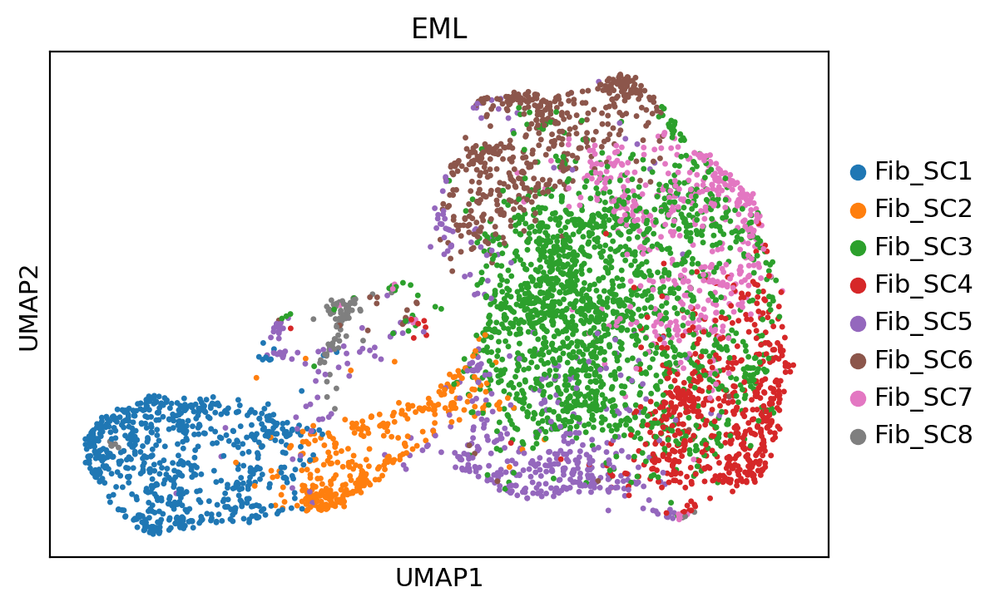

In [54]:
sc.pl.umap(adata,color=["EML"])

In [44]:
#adata = adata[adata.obs["EML"].isin(["Fib_SC3","Fib_SC4","Fib_SC5","Fib_SC6","Fib_SC7"])]

In [45]:
#sc.tl.pca(adata, svd_solver='arpack')
#sc.pp.neighbors(adata, n_neighbors=4, n_pcs=20)
#sc.tl.draw_graph(adata)

#sc.tl.diffmap(adata)
#sc.pp.neighbors(adata, n_neighbors=10, use_rep='X_diffmap')


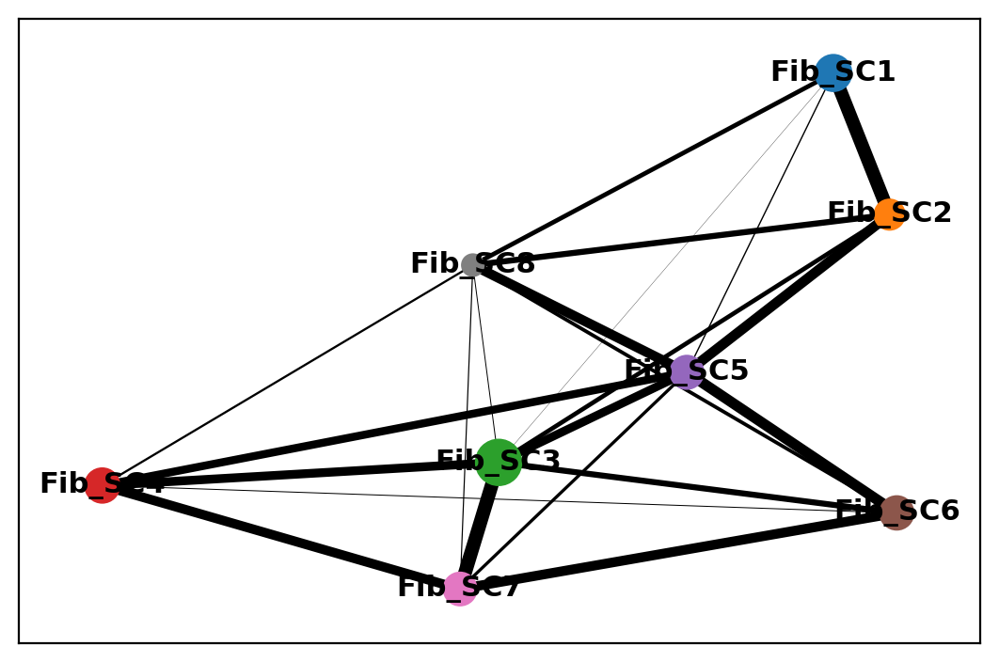

In [56]:
sc.tl.paga(adata, groups='EML')
sc.pl.paga(adata, color=['EML'])

In [ ]:
sc.pl.draw_graph(adata, color=['lEML'], legend_loc='on data')


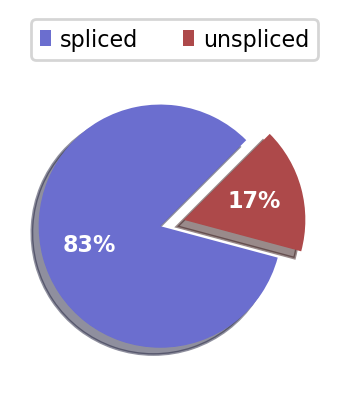

Filtered out 22930 genes that are detected 10 counts (shared).
Normalized count data: X, spliced, unspliced.
Extracted 2000 highly variable genes.
Logarithmized X.
computing neighbors
    finished (0:00:07) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:01) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)
recovering dynamics (using 25/128 cores)


  0%|          | 0/1620 [00:00<?, ?gene/s]

    finished (0:01:15) --> added 
    'fit_pars', fitted parameters for splicing dynamics (adata.var)
computing velocities
    finished (0:00:08) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph (using 1/128 cores)


  0%|          | 0/4598 [00:00<?, ?cells/s]

    finished (0:00:03) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing terminal states
    identified 1 region of root cells and 4 regions of end points .
    finished (0:00:01) --> added
    'root_cells', root cells of Markov diffusion process (adata.obs)
    'end_points', end points of Markov diffusion process (adata.obs)
computing latent time using root_cells as prior
    finished (0:00:02) --> added 
    'latent_time', shared time (adata.obs)
computing velocity graph (using 1/128 cores)


  0%|          | 0/4598 [00:00<?, ?cells/s]

    finished (0:00:08) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


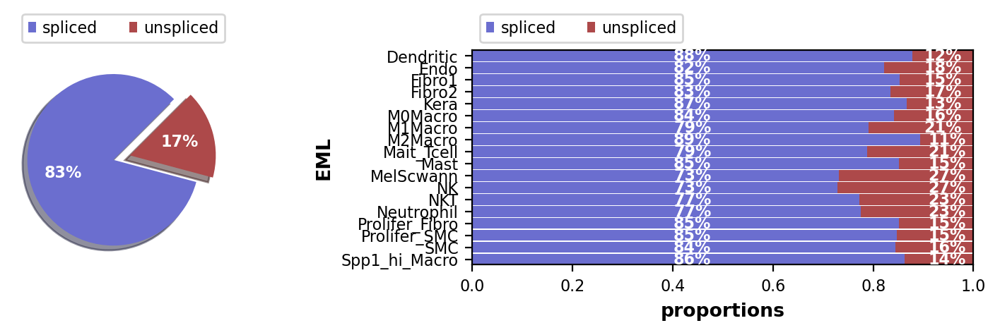

computing velocity embedding
    finished (0:00:01) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


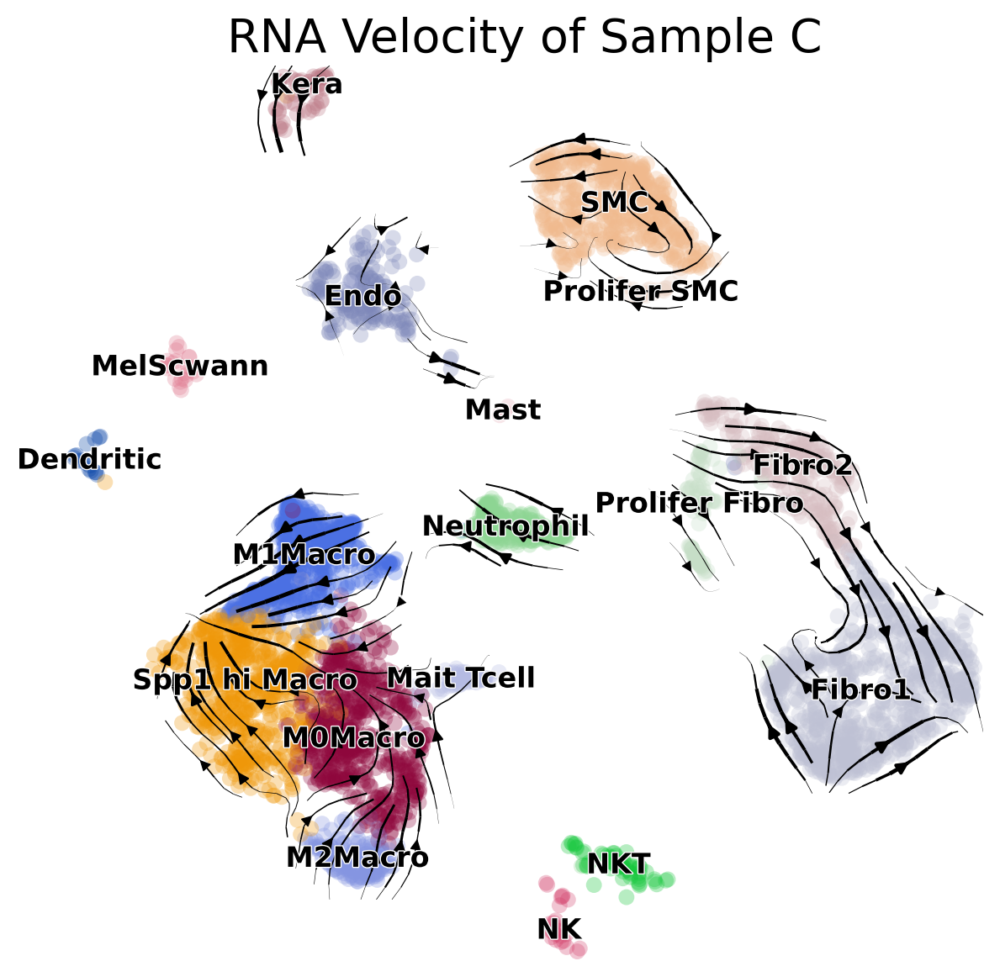

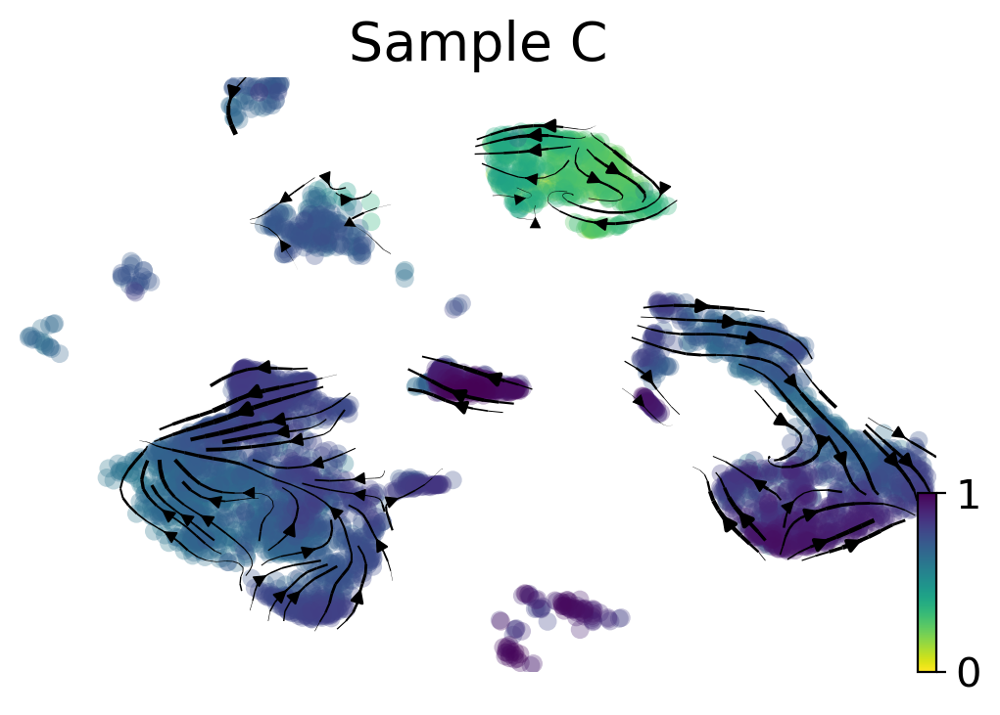

In [3]:
adata = scv.read("/home/chenzh/My_project/SHI_Glu/tmp_data/Aug_2022/Vel/Sample_C.vel.h5ad")
adata.obsm['X_umap']=adata.obs[["UMAP_1","UMAP_2"]].to_numpy()
adata.obsm['X_umap'].shape
scv.pl.proportions(adata)
scv.pp.filter_and_normalize(adata, min_shared_counts=10, n_top_genes=2000)
scv.pp.moments(adata, n_pcs=30, n_neighbors=30)
#sc.pp.regress_out(adata, keys=['nGene'] )
scv.tl.recover_dynamics(adata,n_jobs=25)
scv.tl.velocity(adata, mode='dynamical')
scv.tl.recover_latent_time(adata)
#scv.tl.velocity(adata)
scv.tl.velocity_graph(adata)
scv.pl.proportions(adata, groupby='EML')
scv.pl.velocity_embedding_stream(
    adata, basis='umap',color="EML",fontsize=20,figsize=(7,7),title='RNA Velocity of Sample_C'
)
scv.pl.velocity_embedding_stream(adata,basis="umap",color="latent_time",title='Sample_C',fontsize=20,legend_fontsize=20,min_mass=2)

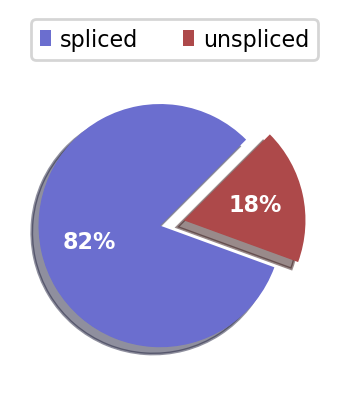

Filtered out 22065 genes that are detected 10 counts (shared).
Normalized count data: X, spliced, unspliced.
Extracted 2000 highly variable genes.
Logarithmized X.
computing neighbors
    finished (0:00:11) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:02) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)
recovering dynamics (using 25/128 cores)


  0%|          | 0/1683 [00:00<?, ?gene/s]

    finished (0:02:09) --> added 
    'fit_pars', fitted parameters for splicing dynamics (adata.var)
computing velocities
    finished (0:00:18) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph (using 1/128 cores)


  0%|          | 0/9271 [00:00<?, ?cells/s]

    finished (0:00:06) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing terminal states
    identified 5 regions of root cells and 6 regions of end points .
    finished (0:00:06) --> added
    'root_cells', root cells of Markov diffusion process (adata.obs)
    'end_points', end points of Markov diffusion process (adata.obs)
computing latent time using root_cells as prior
    finished (0:00:05) --> added 
    'latent_time', shared time (adata.obs)
computing velocity graph (using 1/128 cores)


  0%|          | 0/9271 [00:00<?, ?cells/s]

    finished (0:00:25) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


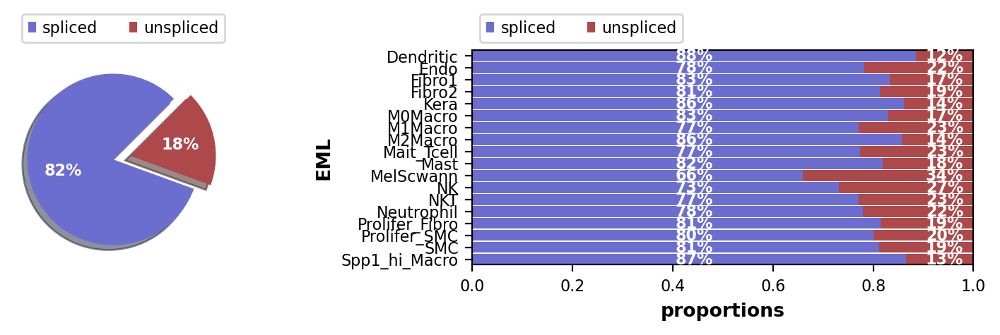

computing velocity embedding
    finished (0:00:02) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


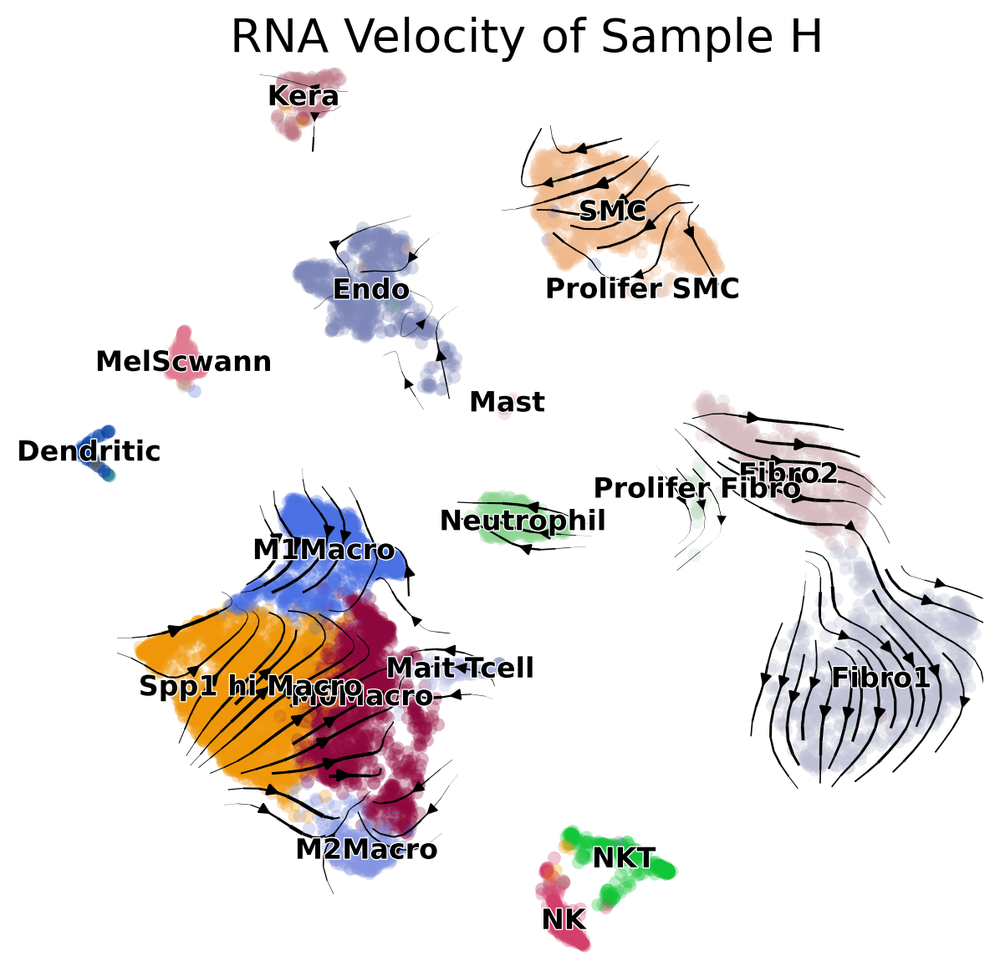

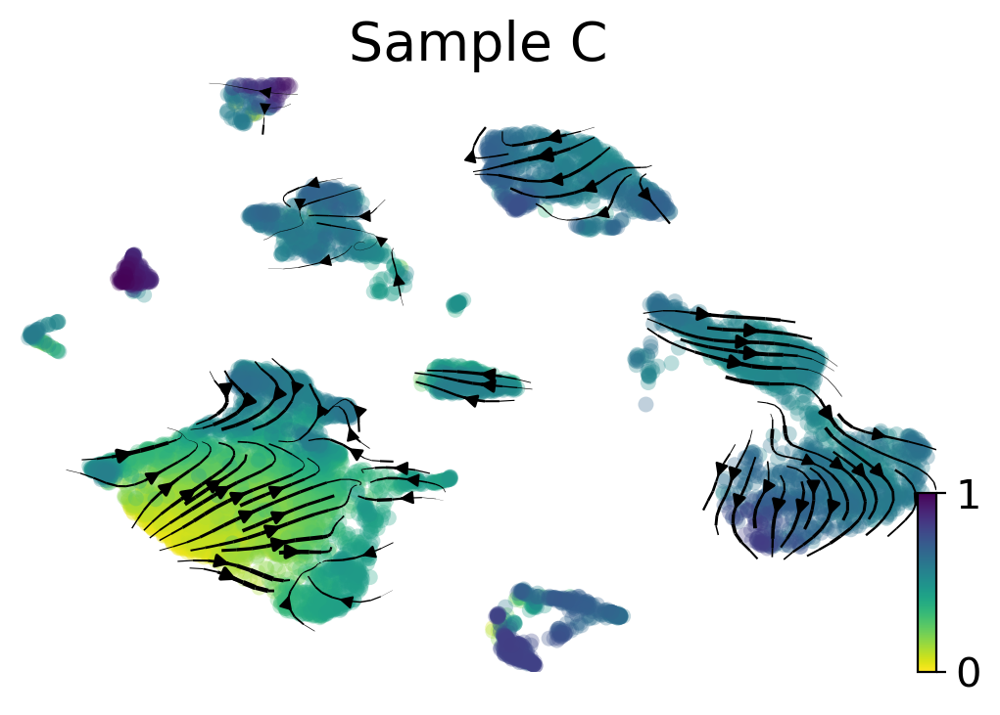

In [4]:
adata = scv.read("/home/chenzh/My_project/SHI_Glu/tmp_data/Aug_2022/Vel/Sample_H.vel.h5ad")
adata.obsm['X_umap']=adata.obs[["UMAP_1","UMAP_2"]].to_numpy()
adata.obsm['X_umap'].shape
scv.pl.proportions(adata)
scv.pp.filter_and_normalize(adata, min_shared_counts=10, n_top_genes=2000)
scv.pp.moments(adata, n_pcs=30, n_neighbors=30)
#sc.pp.regress_out(adata, keys=['nGene'] )
scv.tl.recover_dynamics(adata,n_jobs=25)
scv.tl.velocity(adata, mode='dynamical')
scv.tl.recover_latent_time(adata)
#scv.tl.velocity(adata)
scv.tl.velocity_graph(adata)
scv.pl.proportions(adata, groupby='EML')
scv.pl.velocity_embedding_stream(
    adata, basis='umap',color="EML",fontsize=20,figsize=(7,7),title='RNA Velocity of Sample_H'
)
scv.pl.velocity_embedding_stream(adata,basis="umap",color="latent_time",title='Sample_C',fontsize=20,legend_fontsize=20,min_mass=2)

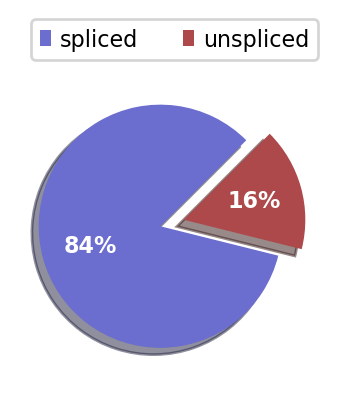

Filtered out 22166 genes that are detected 10 counts (shared).
Normalized count data: X, spliced, unspliced.
Extracted 2000 highly variable genes.
Logarithmized X.
computing neighbors
    finished (0:00:02) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:03) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)
recovering dynamics (using 25/128 cores)


  0%|          | 0/1677 [00:00<?, ?gene/s]

    finished (0:02:20) --> added 
    'fit_pars', fitted parameters for splicing dynamics (adata.var)
computing velocities
    finished (0:00:25) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph (using 1/128 cores)


  0%|          | 0/11011 [00:00<?, ?cells/s]

    finished (0:00:08) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing terminal states
    identified 7 regions of root cells and 5 regions of end points .
    finished (0:00:11) --> added
    'root_cells', root cells of Markov diffusion process (adata.obs)
    'end_points', end points of Markov diffusion process (adata.obs)
computing latent time using root_cells as prior
    finished (0:00:06) --> added 
    'latent_time', shared time (adata.obs)
computing velocity graph (using 1/128 cores)


  0%|          | 0/11011 [00:00<?, ?cells/s]

    finished (0:00:29) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


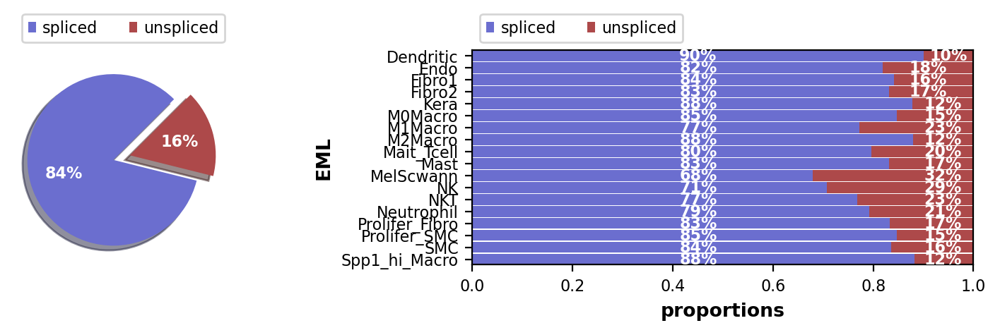

computing velocity embedding
    finished (0:00:03) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


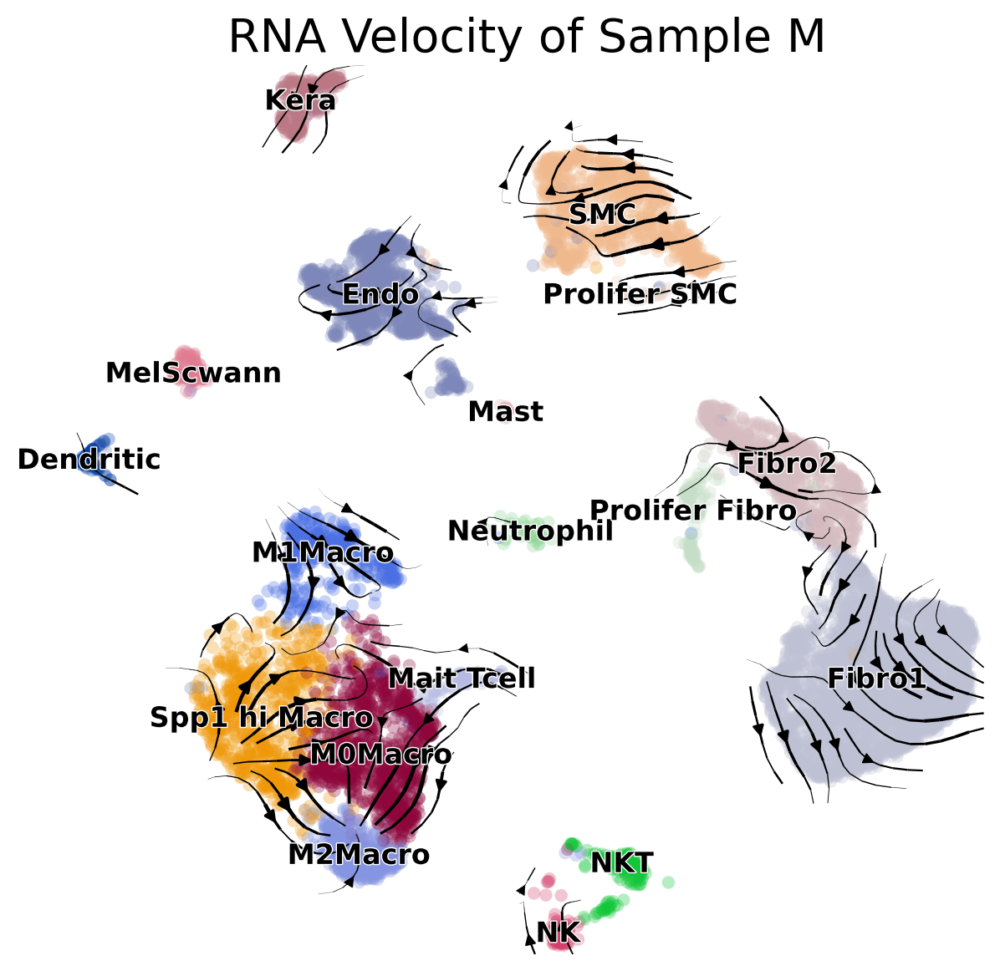

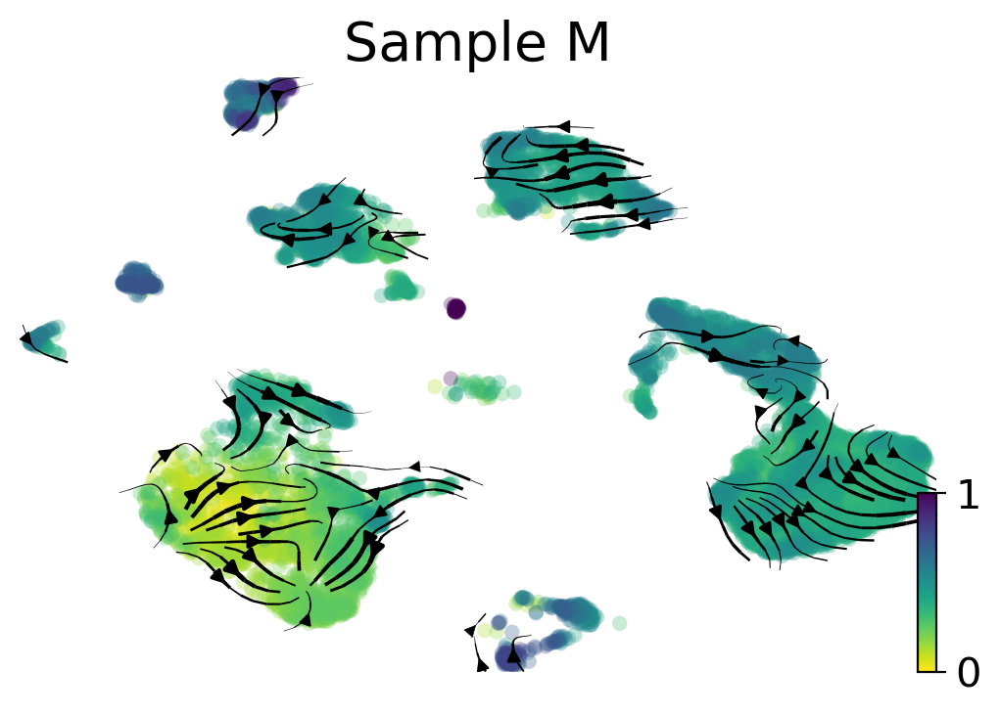

In [5]:
adata = scv.read("/home/chenzh/My_project/SHI_Glu/tmp_data/Aug_2022/Vel/Sample_M.vel.h5ad")
adata.obsm['X_umap']=adata.obs[["UMAP_1","UMAP_2"]].to_numpy()
adata.obsm['X_umap'].shape
scv.pl.proportions(adata)
scv.pp.filter_and_normalize(adata, min_shared_counts=10, n_top_genes=2000)
scv.pp.moments(adata, n_pcs=30, n_neighbors=30)
#sc.pp.regress_out(adata, keys=['nGene'] )
scv.tl.recover_dynamics(adata,n_jobs=25)
scv.tl.velocity(adata, mode='dynamical')
scv.tl.recover_latent_time(adata)
#scv.tl.velocity(adata)
scv.tl.velocity_graph(adata)
scv.pl.proportions(adata, groupby='EML')
scv.pl.velocity_embedding_stream(
    adata, basis='umap',color="EML",fontsize=20,figsize=(7,7),title='RNA Velocity of Sample_M'
)
scv.pl.velocity_embedding_stream(adata,basis="umap",color="latent_time",title='Sample_M',fontsize=20,legend_fontsize=20,min_mass=2)

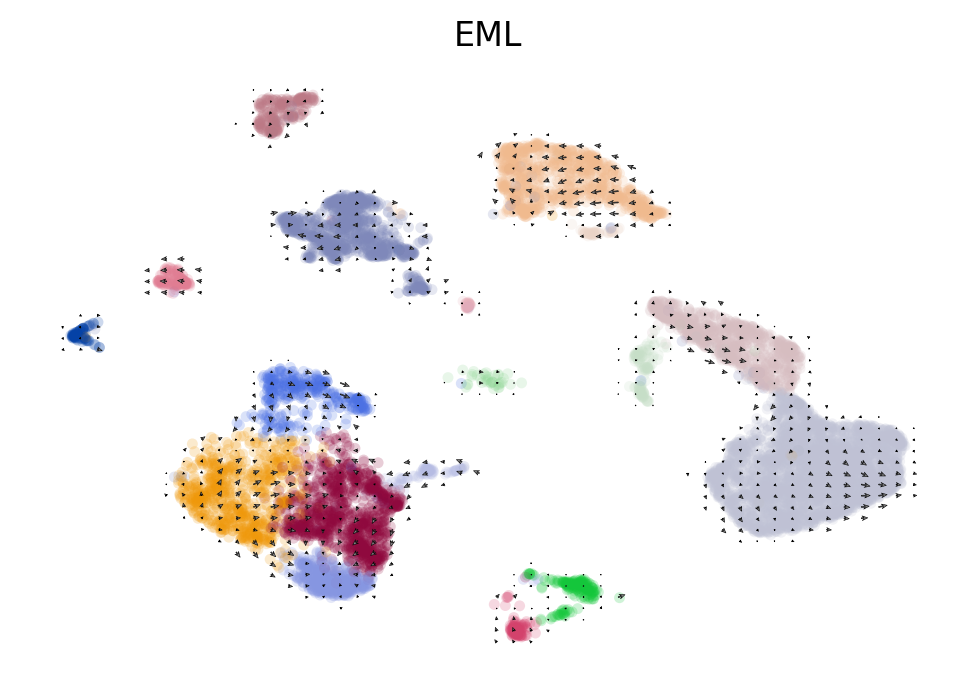

In [6]:
scv.pl.velocity_embedding_grid(adata, basis='umap', color='EML')

Only considering the two last: ['.vel', '.h5ad'].
Only considering the two last: ['.vel', '.h5ad'].


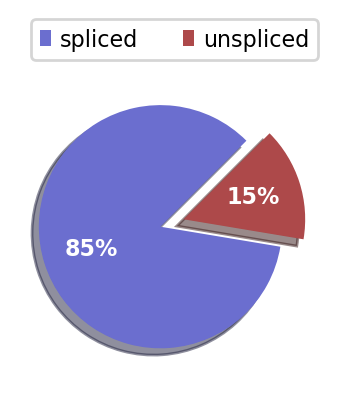

Filtered out 25242 genes that are detected 10 counts (shared).
Normalized count data: X, spliced, unspliced.
Extracted 2000 highly variable genes.
Logarithmized X.
computing neighbors
    finished (0:00:04) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:00) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)
recovering dynamics (using 25/128 cores)


  0%|          | 0/920 [00:00<?, ?gene/s]

    finished (0:00:14) --> added 
    'fit_pars', fitted parameters for splicing dynamics (adata.var)
computing velocities
    finished (0:00:00) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph (using 1/128 cores)


  0%|          | 0/1131 [00:00<?, ?cells/s]

    finished (0:00:00) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing terminal states
    identified 1 region of root cells and 1 region of end points .
    finished (0:00:01) --> added
    'root_cells', root cells of Markov diffusion process (adata.obs)
    'end_points', end points of Markov diffusion process (adata.obs)
computing latent time using root_cells as prior
    finished (0:00:00) --> added 
    'latent_time', shared time (adata.obs)
computing velocity graph (using 1/128 cores)


  0%|          | 0/1131 [00:00<?, ?cells/s]

    finished (0:00:01) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


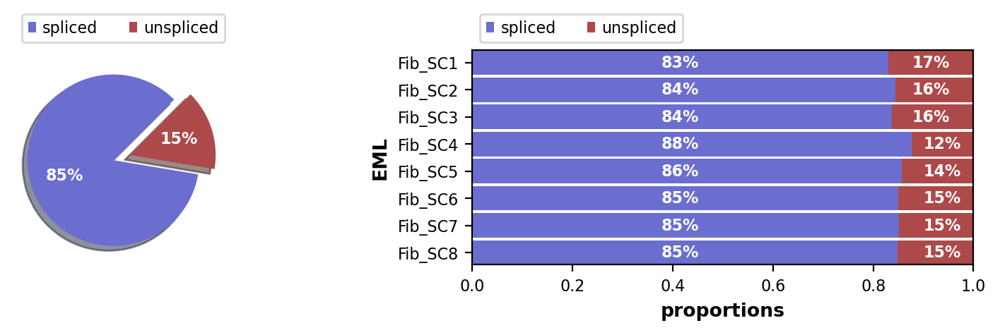

computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


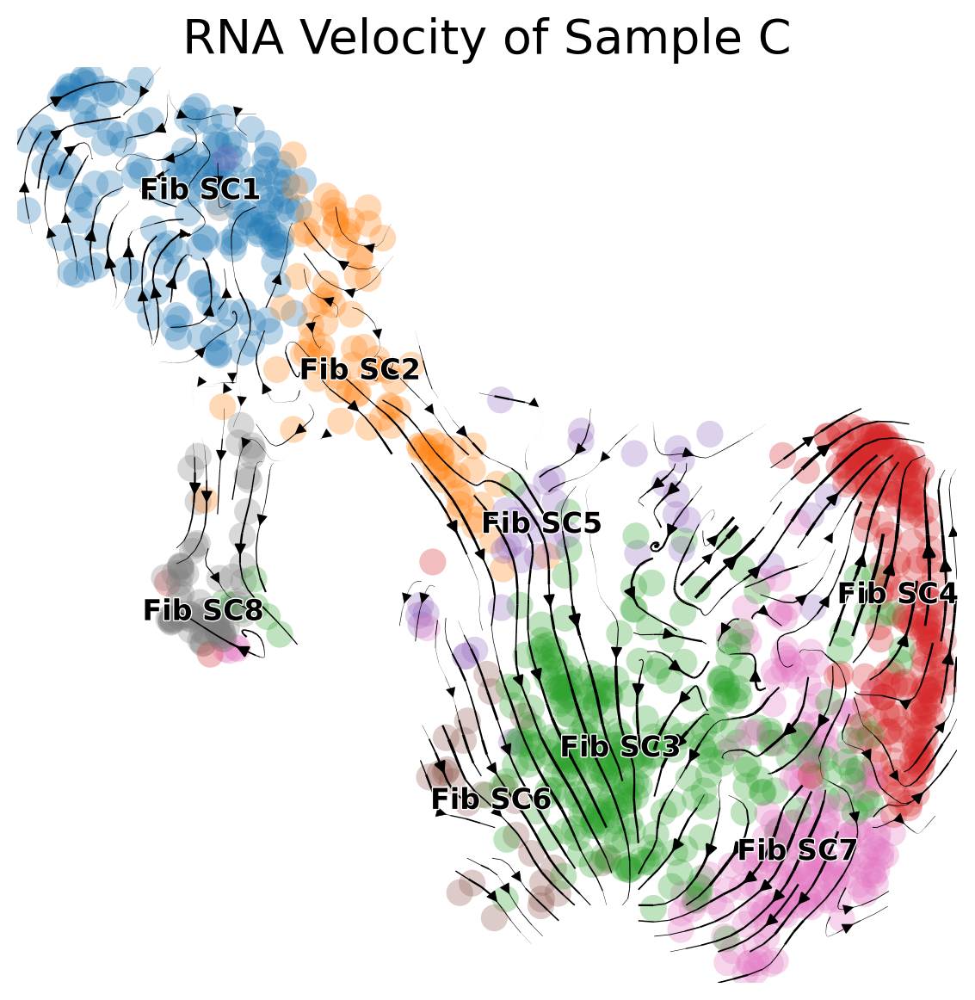

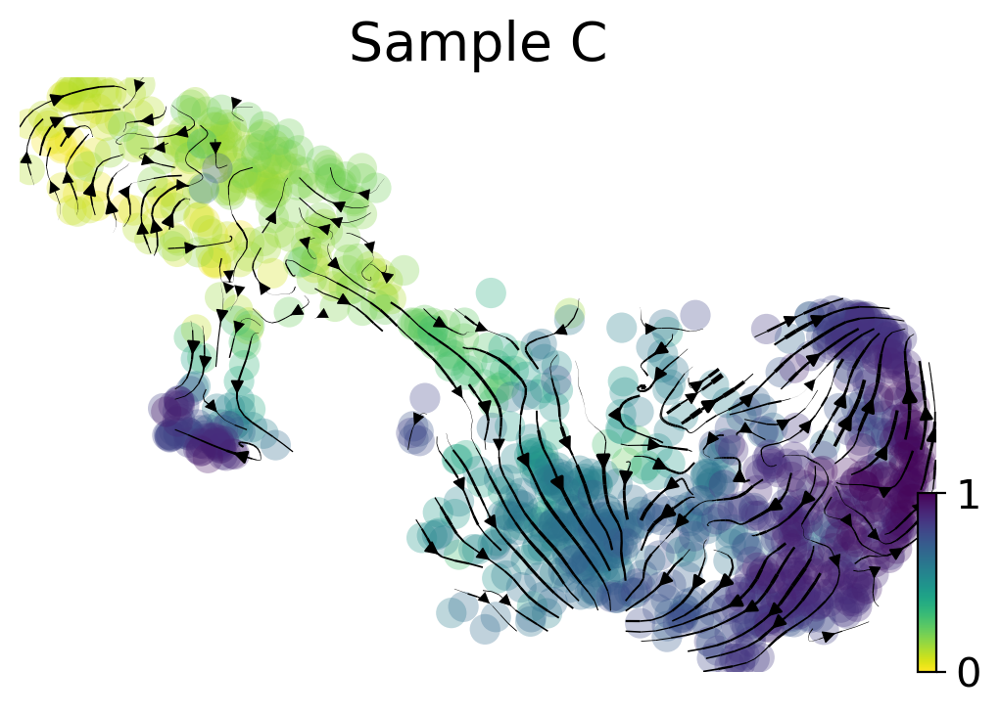

running PAGA using priors: ['velocity_pseudotime']
    finished (0:00:00) --> added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns)
    'paga/transitions_confidence', velocity transitions (adata.uns)


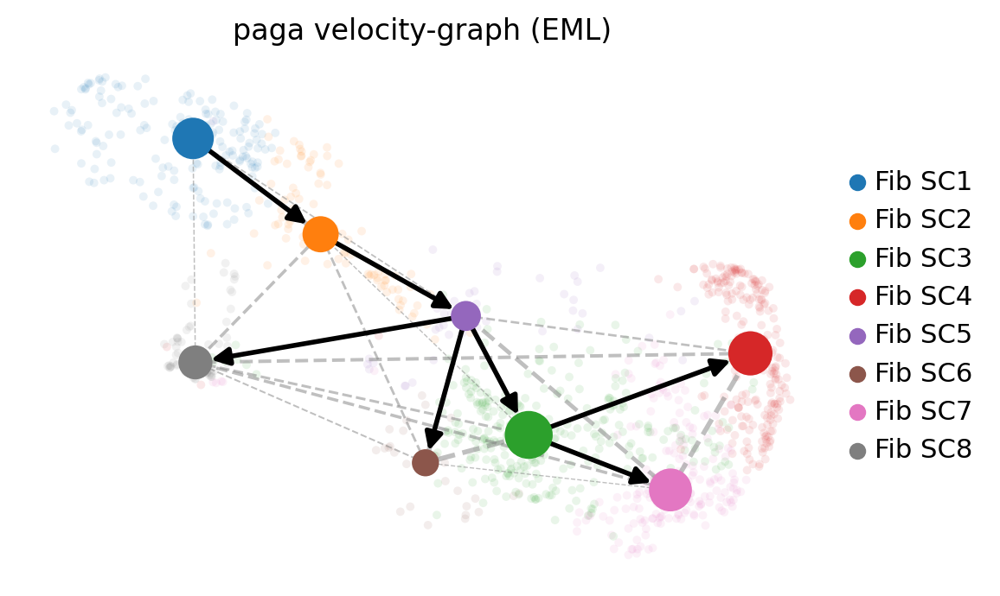

In [3]:
adata = scv.read("/home/chenzh/My_project/SHI_Glu/tmp_data/Aug_2022/Vel/Sample_C.fibro.vel.h5ad")
adata.obsm['X_umap']=adata.obs[["UMAP_1","UMAP_2"]].to_numpy()
adata.obsm['X_umap'].shape
scv.pl.proportions(adata)
scv.pp.filter_and_normalize(adata, min_shared_counts=10, n_top_genes=2000)
scv.pp.moments(adata, n_pcs=30, n_neighbors=30)
#sc.pp.regress_out(adata, keys=['nGene'] )
scv.tl.recover_dynamics(adata,n_jobs=25)
scv.tl.velocity(adata, mode='dynamical')
scv.tl.recover_latent_time(adata)
#scv.tl.velocity(adata)
scv.tl.velocity_graph(adata)
scv.pl.proportions(adata, groupby='EML')
scv.pl.velocity_embedding_stream(
    adata, basis='umap',color="EML",fontsize=20,figsize=(7,7),title='RNA Velocity of Sample_C'
)
scv.pl.velocity_embedding_stream(adata,basis="umap",color="latent_time",title='Sample_C',fontsize=20,legend_fontsize=20,min_mass=2)
scv.tl.paga(adata, groups='EML')
scv.pl.paga(adata, basis='umap', size=50, alpha=.1,min_edge_width=2, node_size_scale=1.5)

saving figure to file tmp_data/fig_pdf/fig.vel.sample.C.png


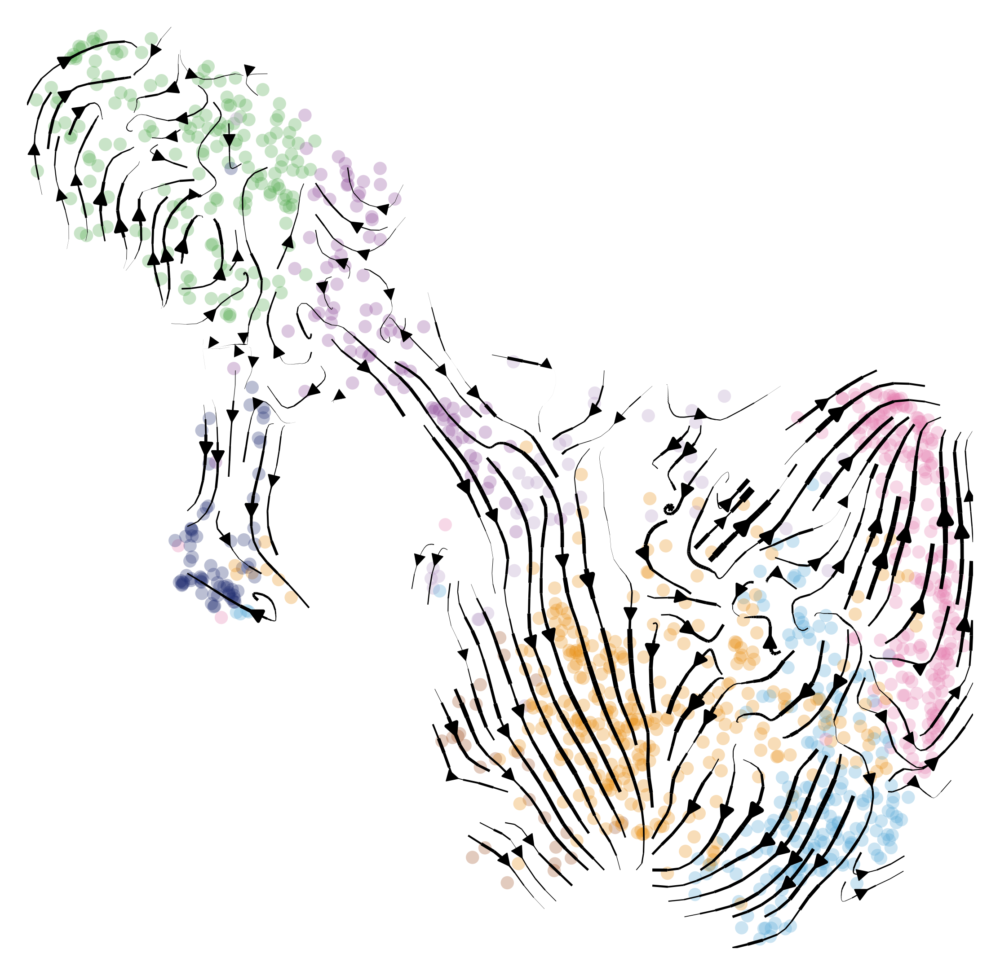

In [4]:
scv.pl.velocity_embedding_stream(
    adata, basis='umap',color="EML",fontsize=1,figsize=(4.5,4.5),title='',arrow_size=0.75,size =50,dpi=300,palette=p_col_set,legend_loc='none',save="tmp_data/fig_pdf/fig.vel.sample.C.png")

Only considering the two last: ['.vel', '.h5ad'].
Only considering the two last: ['.vel', '.h5ad'].


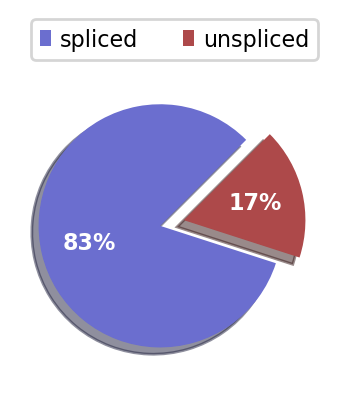

Filtered out 24765 genes that are detected 10 counts (shared).
Normalized count data: X, spliced, unspliced.
Extracted 2000 highly variable genes.
Logarithmized X.
computing neighbors
    finished (0:00:00) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:00) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)
recovering dynamics (using 25/128 cores)


  0%|          | 0/1179 [00:00<?, ?gene/s]

    finished (0:00:15) --> added 
    'fit_pars', fitted parameters for splicing dynamics (adata.var)
computing velocities
    finished (0:00:01) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph (using 1/128 cores)


  0%|          | 0/1609 [00:00<?, ?cells/s]

    finished (0:00:01) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing terminal states
    identified 0 region of root cells and 1 region of end points .
    finished (0:00:00) --> added
    'root_cells', root cells of Markov diffusion process (adata.obs)
    'end_points', end points of Markov diffusion process (adata.obs)
computing latent time using root_cells as prior
    finished (0:00:00) --> added 
    'latent_time', shared time (adata.obs)
computing velocity graph (using 1/128 cores)


  0%|          | 0/1609 [00:00<?, ?cells/s]

    finished (0:00:02) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


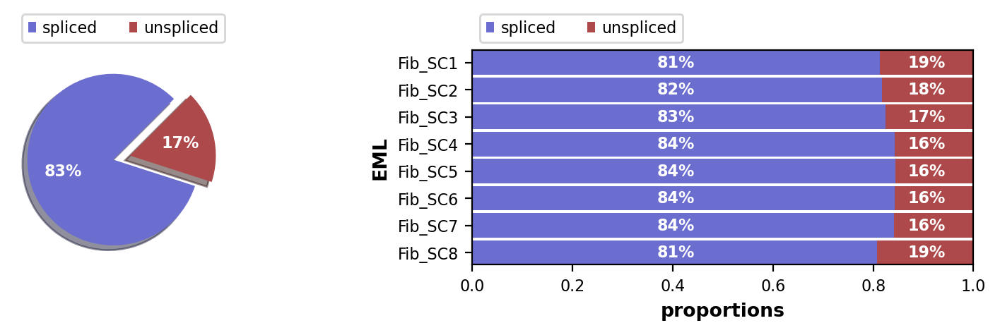

computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


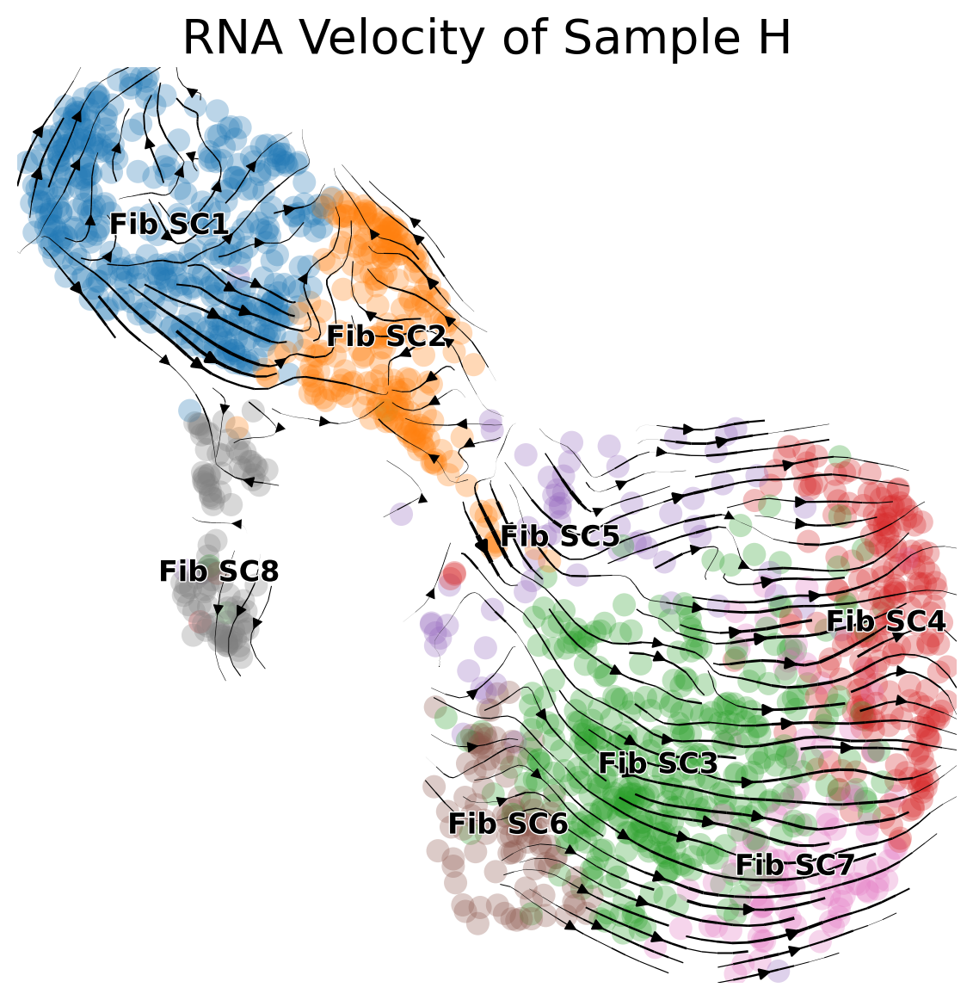

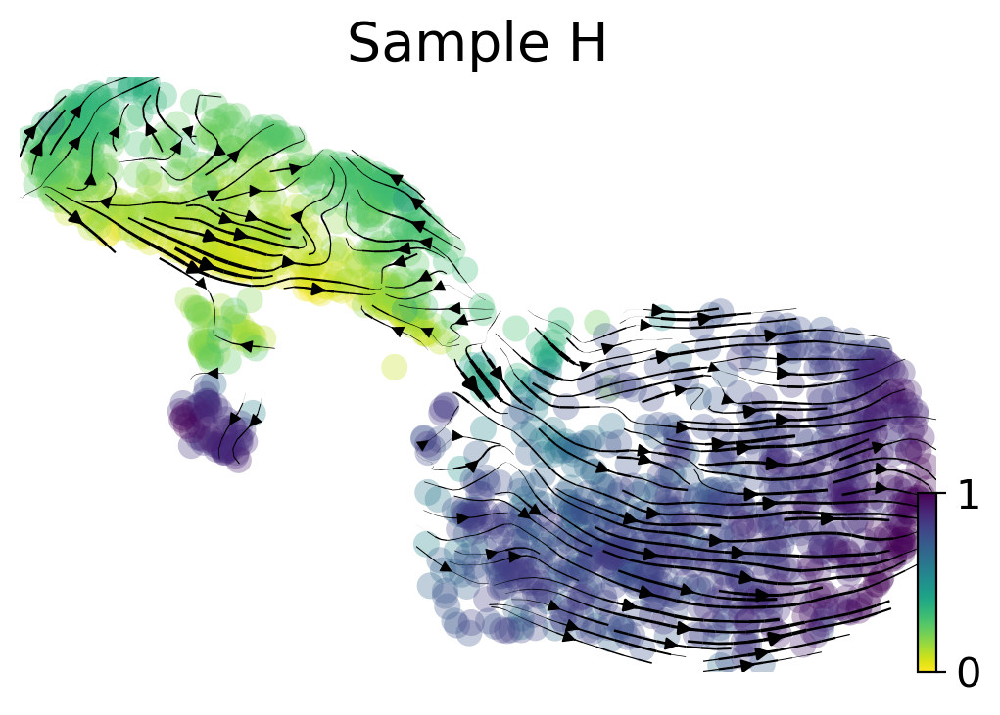

In [5]:
adata = scv.read("/home/chenzh/My_project/SHI_Glu/tmp_data/Aug_2022/Vel/Sample_H.fibro.vel.h5ad")
adata.obsm['X_umap']=adata.obs[["UMAP_1","UMAP_2"]].to_numpy()
adata.obsm['X_umap'].shape
scv.pl.proportions(adata)
scv.pp.filter_and_normalize(adata, min_shared_counts=10, n_top_genes=2000)
scv.pp.moments(adata, n_pcs=30, n_neighbors=30)
#sc.pp.regress_out(adata, keys=['nGene'] )
scv.tl.recover_dynamics(adata,n_jobs=25)
scv.tl.velocity(adata, mode='dynamical')
scv.tl.recover_latent_time(adata)
#scv.tl.velocity(adata)
scv.tl.velocity_graph(adata)
scv.pl.proportions(adata, groupby='EML')
scv.pl.velocity_embedding_stream(
    adata, basis='umap',color="EML",fontsize=20,figsize=(7,7),title='RNA Velocity of Sample_H'
)
scv.pl.velocity_embedding_stream(adata,basis="umap",color="latent_time",title='Sample_H',fontsize=20,legend_fontsize=20,min_mass=2)

saving figure to file tmp_data/fig_pdf/fig.vel.sample.H.png


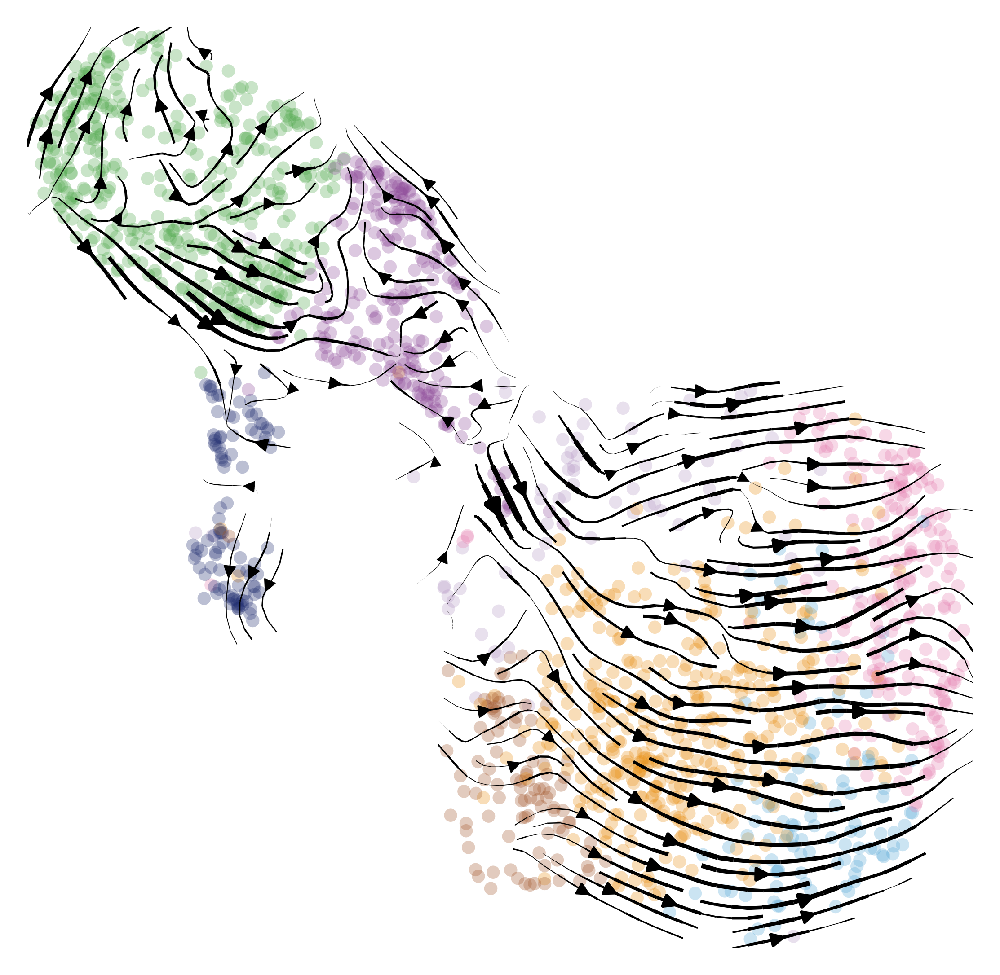

In [6]:
scv.pl.velocity_embedding_stream(
    adata, basis='umap',color="EML",fontsize=1,figsize=(4.5,4.5),title='',arrow_size=0.75,size =50,dpi=300,palette=p_col_set,legend_loc='none',save="tmp_data/fig_pdf/fig.vel.sample.H.png")

Only considering the two last: ['.vel', '.h5ad'].
Only considering the two last: ['.vel', '.h5ad'].


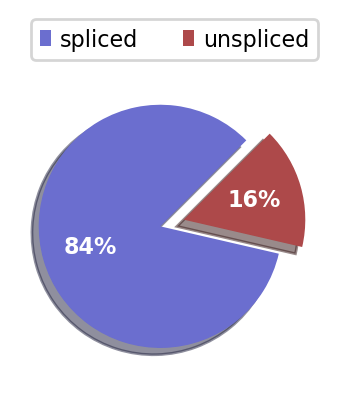

Filtered out 24392 genes that are detected 10 counts (shared).
Normalized count data: X, spliced, unspliced.
Extracted 2000 highly variable genes.
Logarithmized X.
computing neighbors
    finished (0:00:01) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:01) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)
recovering dynamics (using 25/128 cores)


  0%|          | 0/943 [00:00<?, ?gene/s]

    finished (0:00:34) --> added 
    'fit_pars', fitted parameters for splicing dynamics (adata.var)
computing velocities
    finished (0:00:05) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph (using 1/128 cores)


  0%|          | 0/4929 [00:00<?, ?cells/s]

    finished (0:00:03) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing terminal states
    identified 2 regions of root cells and 1 region of end points .
    finished (0:00:02) --> added
    'root_cells', root cells of Markov diffusion process (adata.obs)
    'end_points', end points of Markov diffusion process (adata.obs)
computing latent time using root_cells as prior
    finished (0:00:02) --> added 
    'latent_time', shared time (adata.obs)
computing velocity graph (using 1/128 cores)


  0%|          | 0/4929 [00:00<?, ?cells/s]

    finished (0:00:09) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


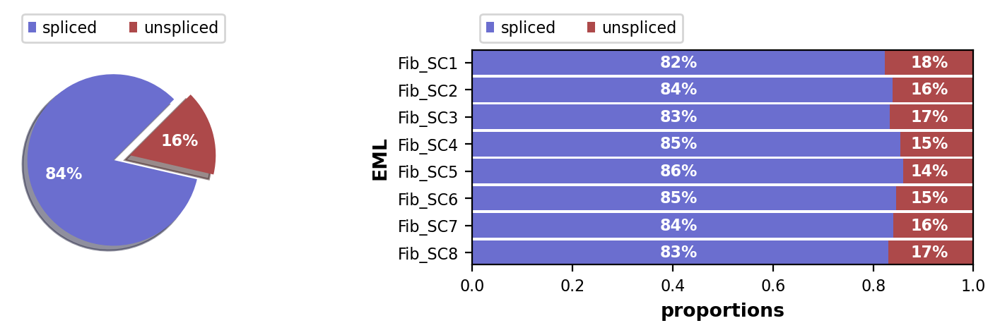

computing velocity embedding
    finished (0:00:01) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


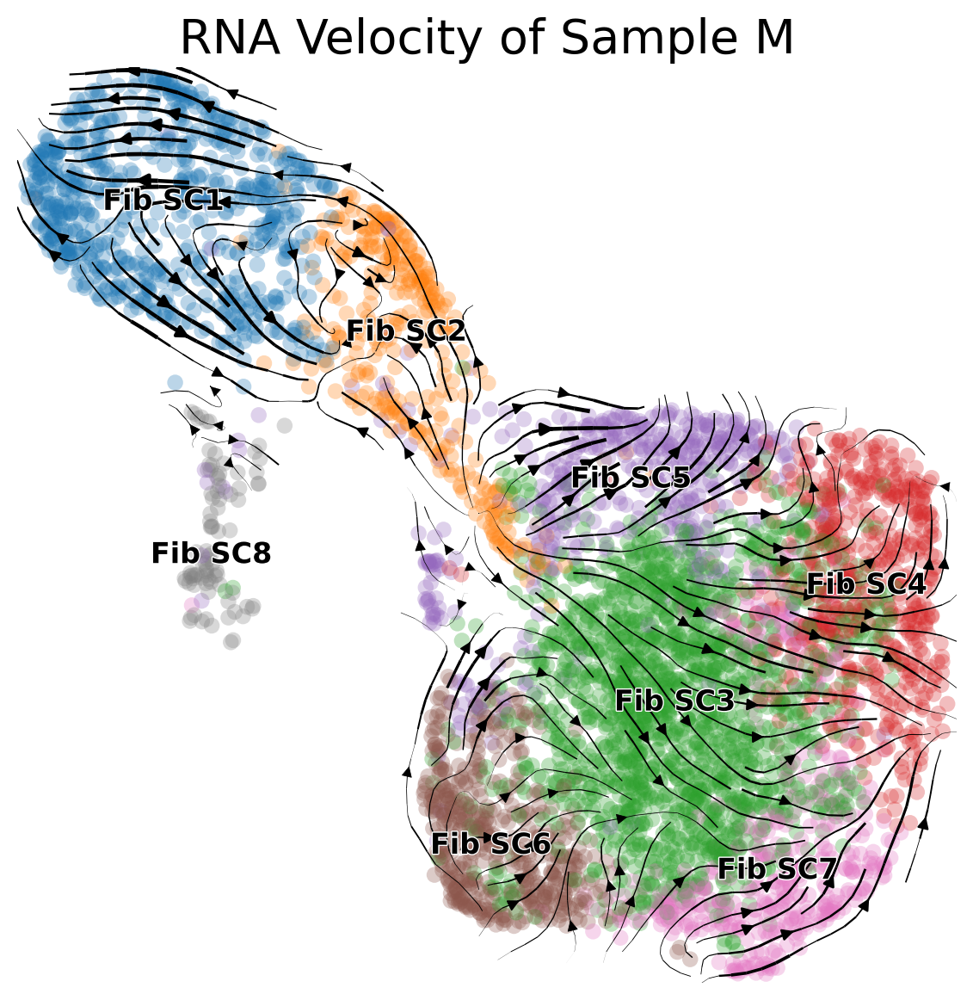

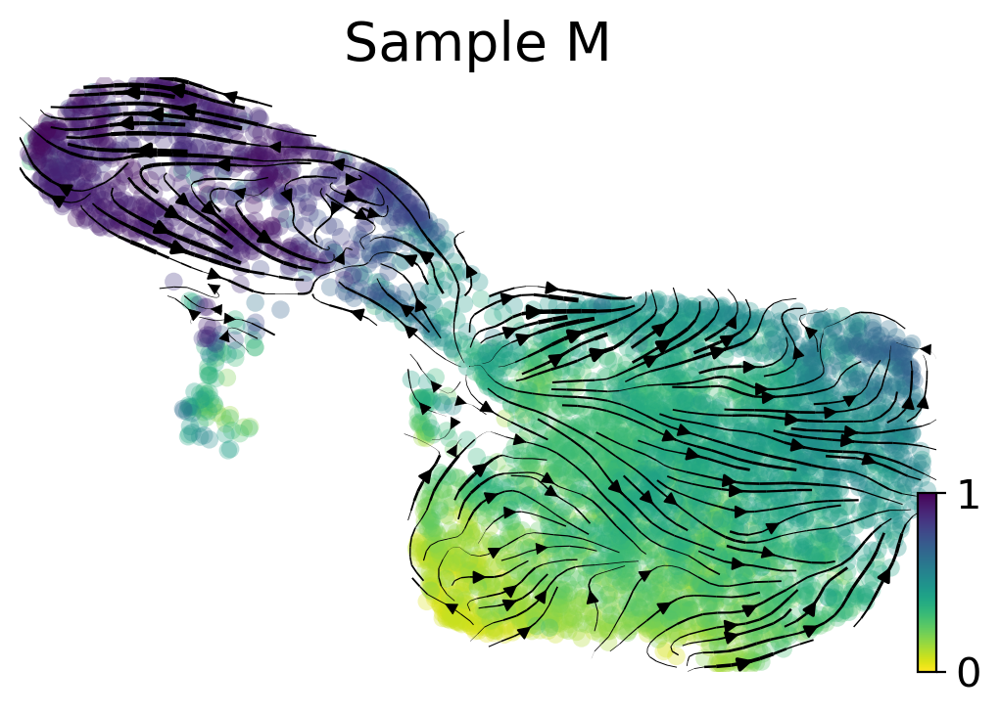

In [7]:
adata = scv.read("/home/chenzh/My_project/SHI_Glu/tmp_data/Aug_2022/Vel/Sample_M.fibro.vel.h5ad")
adata.obsm['X_umap']=adata.obs[["UMAP_1","UMAP_2"]].to_numpy()
adata.obsm['X_umap'].shape
scv.pl.proportions(adata)
scv.pp.filter_and_normalize(adata, min_shared_counts=10, n_top_genes=2000)
scv.pp.moments(adata, n_pcs=30, n_neighbors=30)
#sc.pp.regress_out(adata, keys=['nGene'] )
scv.tl.recover_dynamics(adata,n_jobs=25)
scv.tl.velocity(adata, mode='dynamical')
scv.tl.recover_latent_time(adata)
#scv.tl.velocity(adata)
scv.tl.velocity_graph(adata)
scv.pl.proportions(adata, groupby='EML')
scv.pl.velocity_embedding_stream(
    adata, basis='umap',color="EML",fontsize=20,figsize=(7,7),title='RNA Velocity of Sample_M'
)
scv.pl.velocity_embedding_stream(adata,basis="umap",color="latent_time",title='Sample_M',fontsize=20,legend_fontsize=20,min_mass=2)

saving figure to file tmp_data/fig_pdf/fig.vel.sample.M.png


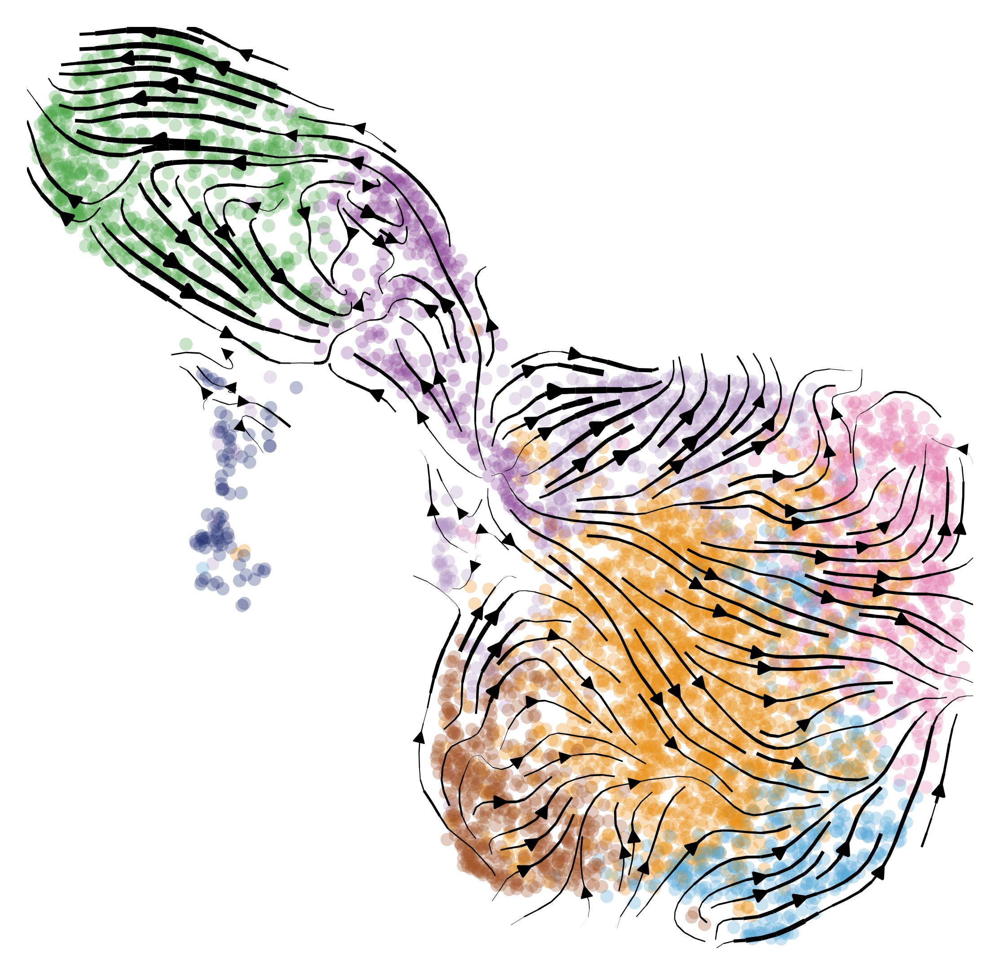

In [8]:
scv.pl.velocity_embedding_stream(
    adata, basis='umap',color="EML",fontsize=1,figsize=(4.5,4.5),title='',arrow_size=0.75,size =50,dpi=300,palette=p_col_set,legend_loc='none',save="tmp_data/fig_pdf/fig.vel.sample.M.png")

running PAGA using priors: ['velocity_pseudotime']
    finished (0:00:01) --> added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns)
    'paga/transitions_confidence', velocity transitions (adata.uns)


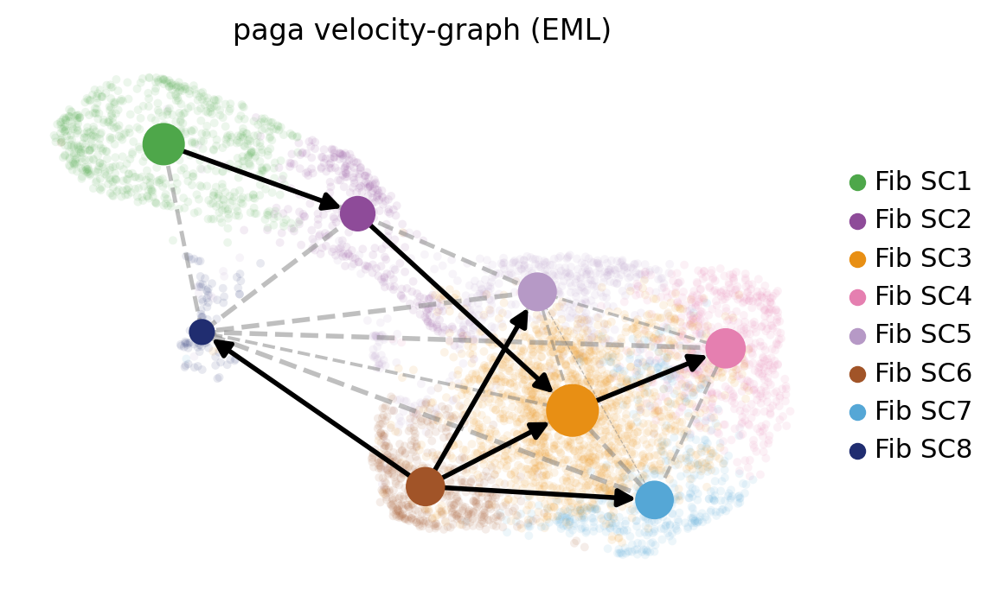

In [9]:
scv.tl.paga(adata, groups='EML')
scv.pl.paga(adata, basis='umap', size=50, alpha=.1,min_edge_width=2, node_size_scale=1.5,palette=p_col_set,)

saving figure to file tmp_data/fig_pdf/fig.paga.sample.M.png


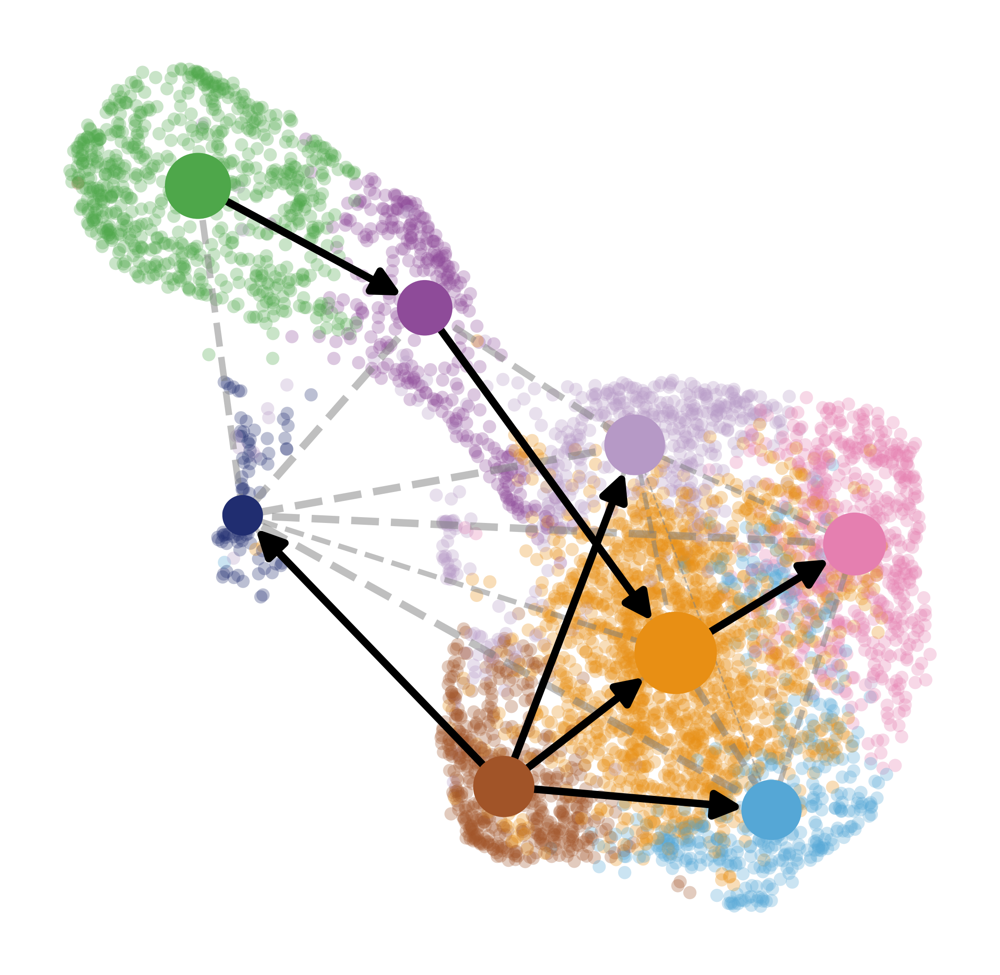

In [13]:
scv.pl.paga(adata, basis='umap',figsize=(4.5,4.5),  alpha=.3,min_edge_width=2, title='',node_size_scale=1.5,size =50,dpi=300,palette=p_col_set,legend_loc='none',save="tmp_data/fig_pdf/fig.paga.sample.M.png")

Trying to set attribute `.uns` of view, copying.


running PAGA using priors: ['velocity_pseudotime']
    finished (0:00:01) --> added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns)
    'paga/transitions_confidence', velocity transitions (adata.uns)


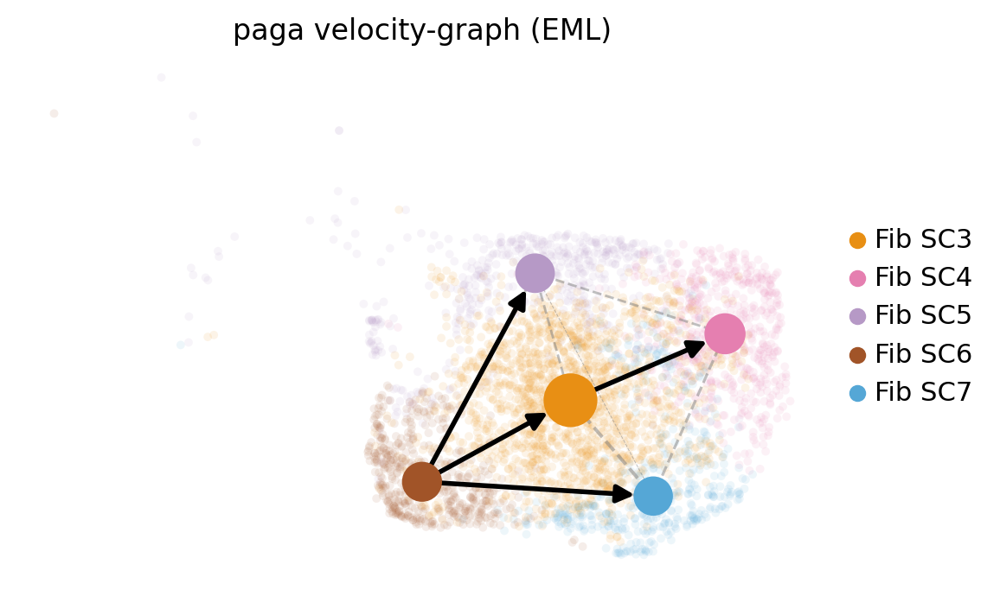

saving figure to file tmp_data/fig_pdf/fig.paga.sample.M.sub.png


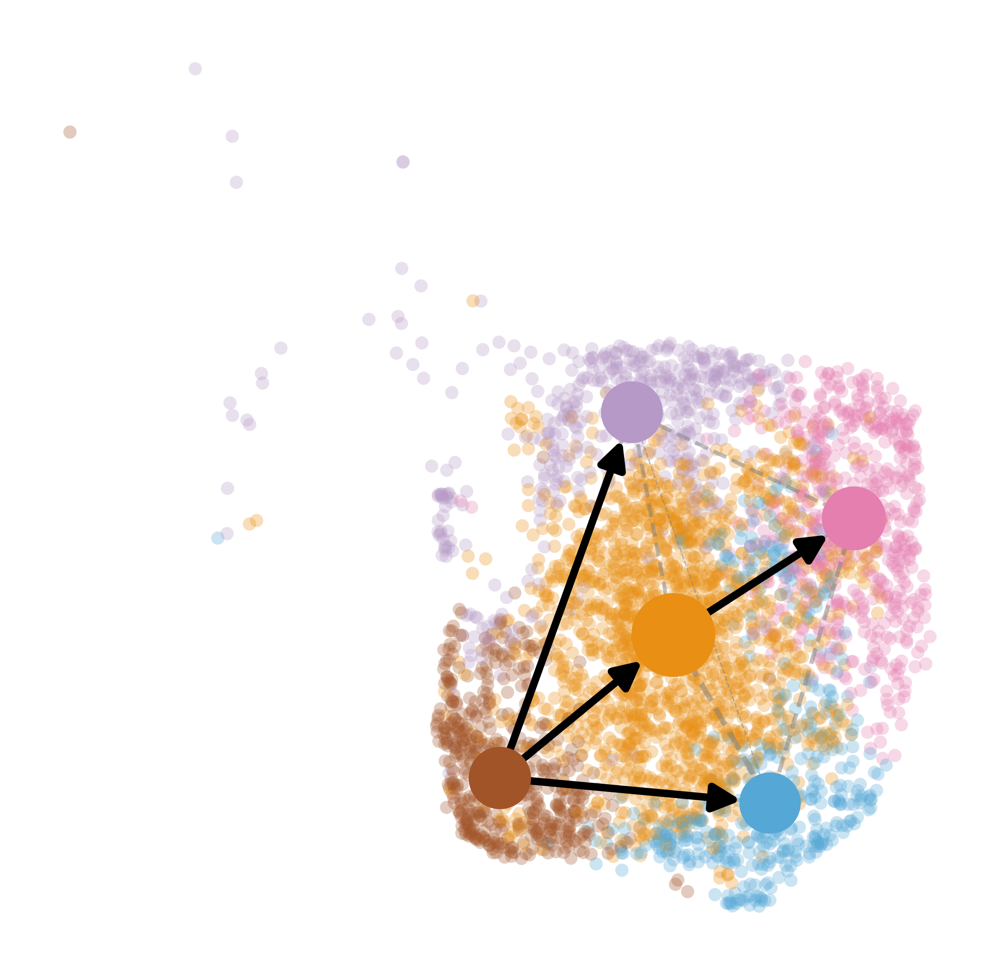

In [16]:
adata_sub = adata[adata.obs["EML"].isin(["Fib_SC3","Fib_SC4","Fib_SC5","Fib_SC6","Fib_SC7"])]
scv.tl.paga(adata_sub, groups='EML')
scv.pl.paga(adata_sub, basis='umap', size=50, alpha=.1,min_edge_width=2, node_size_scale=1.5,palette=p_col_set,)
scv.pl.paga(adata_sub, basis='umap',figsize=(4.5,4.5),  alpha=.3,min_edge_width=2, title='',node_size_scale=1.5,size =50,dpi=300,palette=p_col_set,legend_loc='none',save="tmp_data/fig_pdf/fig.paga.sample.M.sub.png")

computing latent time using root_cells as prior
    finished (0:00:02) --> added 
    'latent_time', shared time (adata.obs)


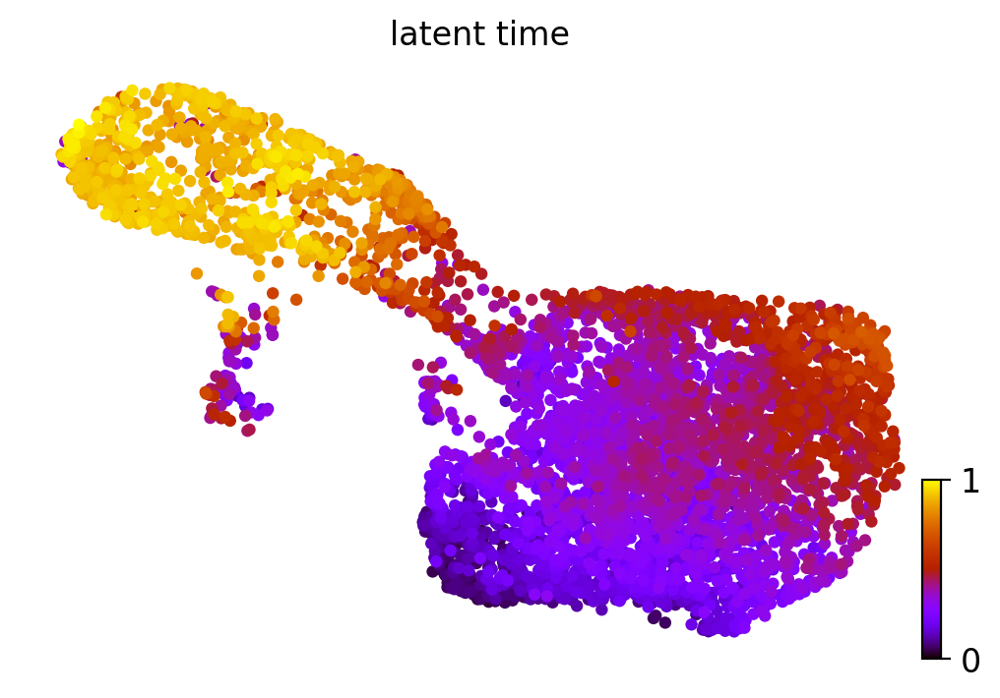

In [99]:
scv.tl.latent_time(adata)
scv.pl.scatter(adata, color='latent_time', color_map='gnuplot', size=80)


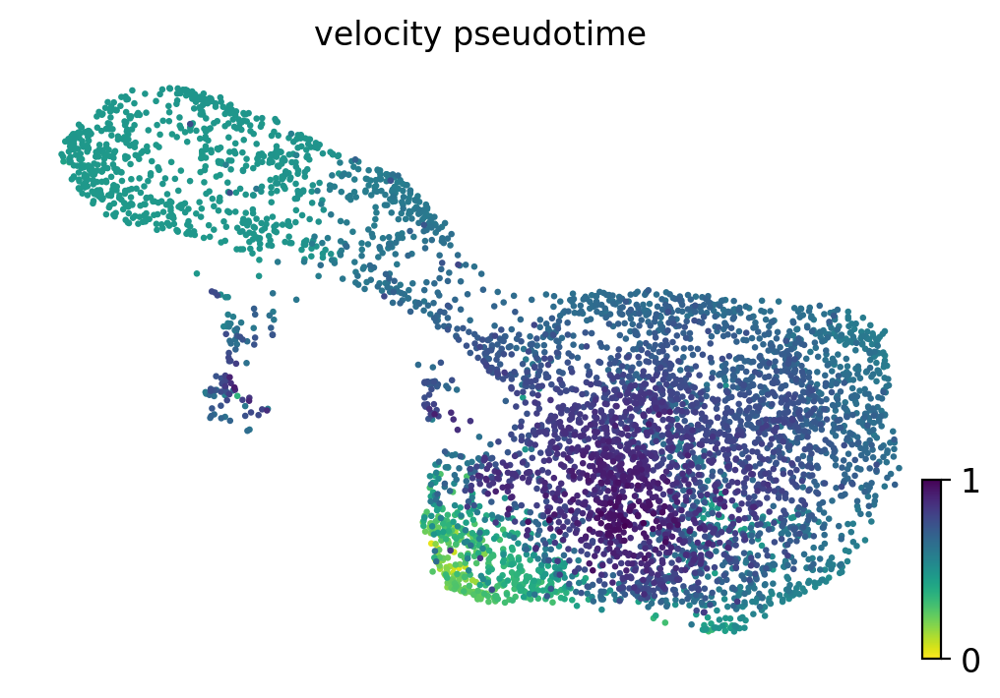

In [111]:

#scv.tl.velocity_pseudotime(adata,groupby="EML",groups=["FibroSub_1","FibroSub_6"])
#scv.pl.scatter(adata, color='velocity_pseudotime')


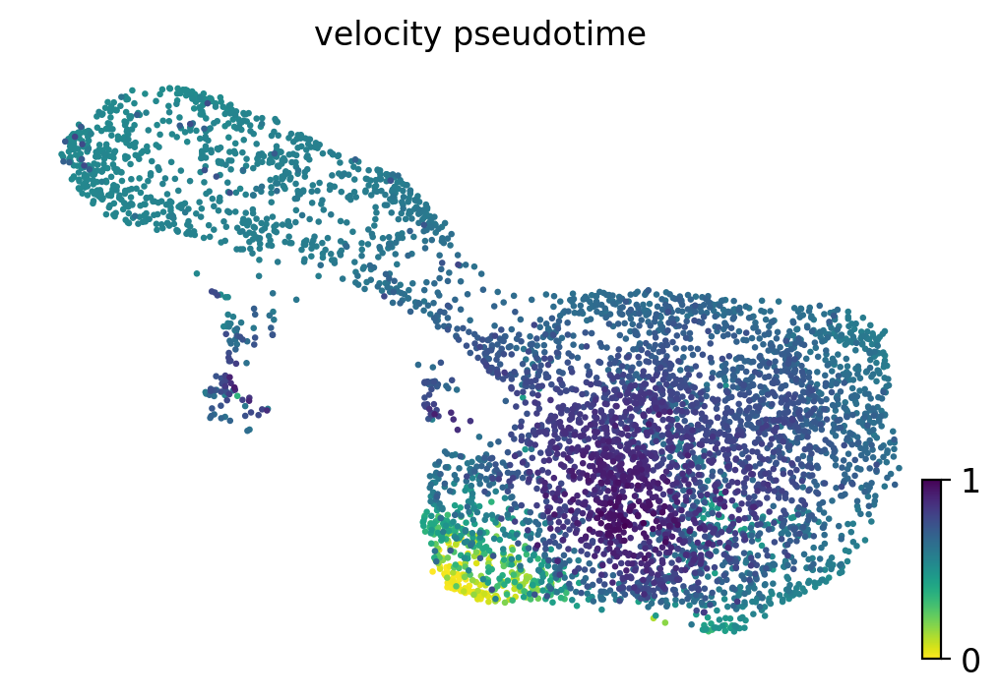

In [110]:
scv.tl.velocity_pseudotime(adata)
scv.pl.scatter(adata, color='velocity_pseudotime')

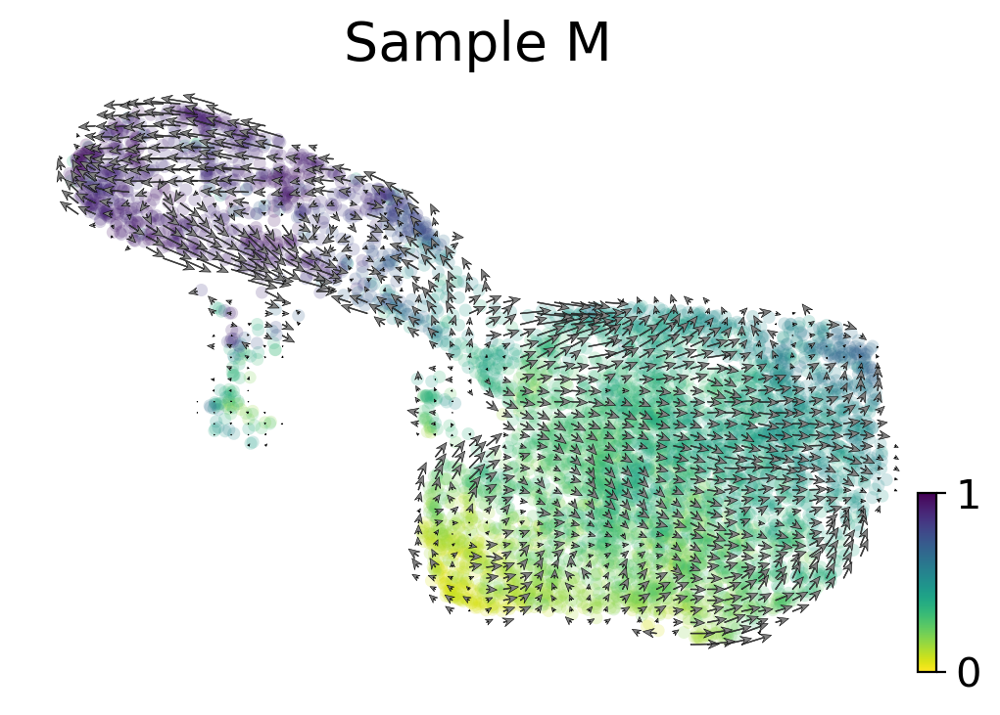

In [113]:
scv.pl.velocity_embedding_grid(adata,basis="umap",color="latent_time",title='Sample_M',arrow_size=2,arrow_length=5,fontsize=20,legend_fontsize=20,min_mass=2)

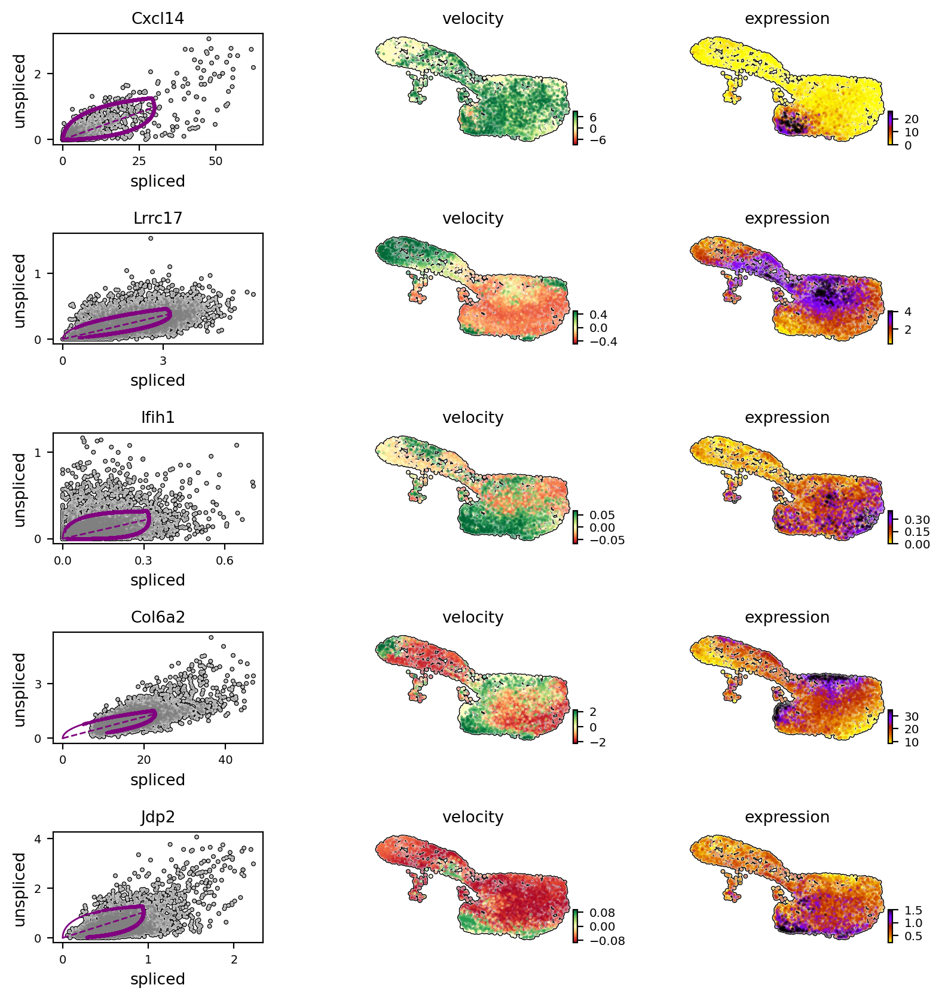

In [39]:
#scv.pl.velocity_embedding_stream(adata, basis='umap',color="EML",fontsize=20,figsize=(7,7),title='RNA Velocity of Sample_M')
scv.pl.velocity(adata, ['Cxcl14','Lrrc17','Ifih1',"Col6a2","Jdp2"],add_outline=True, ncols=1)


In [15]:
scv.tl.rank_velocity_genes(adata, groupby='EML', min_corr=.3)

df = scv.DataFrame(adata.uns['rank_velocity_genes']['names'])
df.head(10)

ranking velocity genes
    finished (0:00:00) --> added 
    'rank_velocity_genes', sorted scores by group ids (adata.uns) 
    'spearmans_score', spearmans correlation scores (adata.var)


,FibroSub_1,FibroSub_2,FibroSub_3,FibroSub_4,FibroSub_5,FibroSub_6,FibroSub_7,FibroSub_8
0,Lrrc17,Srpx2,Panx1,Steap2,Amd1,Ifih1,Fabp4,Plxnd1
1,Cemip,Pdgfrb,Cald1,Chrdl1,Pamr1,Col6a2,AABR07007032.1,Plcb1
2,Ptprf,Hsd17b8,Fbn1,Tnfrsf21,Trib1,Jdp2,Heca,Slc8b1
3,Tfap2c,Septin8,Foxp2,Txnrd1,AABR07068316.1,Cotl1,Bmp2,Jade1
4,Prss23,Ncam1,Atp8b1,Hs6st1,Tfrc,Akap12,Gpc3,Flt1
5,Mmp13,C1qtnf7,Pcsk6,Samd4a,Ipmk,Pdlim1,Ccn4,Itga4
6,Fosb,Clic2,Timp1,Fam167a,Pltp,Arhgef7,Dnajb1,Trps1
7,Ipmk,S100b,Gpm6b,Cacna1a,Adamts1,Ptx3,Col12a1,Gpc3
8,Igfbp3,Xdh,Spon1,Dab2,Msmo1,Dpt,Tnfaip6,Nfia
9,Zfp292,Rnf144a,Sacs,Chsy1,Lmna,Txnrd1,Plau,Meox2


In [19]:
scv.pl.velocity_graph(adata, threshold=.1,color="EML")
x, y = scv.utils.get_cell_transitions(adata, basis='umap', starting_cell=70)
ax = scv.pl.velocity_graph(adata, c='lightgrey', edge_width=.05, show=False)
ax = scv.pl.scatter(adata, x=x, y=y, s=120, c='ascending', cmap='gnuplot', ax=ax)
adata.obs_keys

<bound method AnnData.obs_keys of AnnData object with n_obs × n_vars = 4929 × 2000
    obs: 'orig.ident', 'nCount_spliced', 'nFeature_spliced', 'nCount_unspliced', 'nFeature_unspliced', 'nCount_ambiguous', 'nFeature_ambiguous', 'nGene', 'libsize', 'mt.perc', 'sample', 'pred', 'phase_seurat', 'EML', 'seurat_clusters', 'big_EML', 'UMAP_1', 'UMAP_2', 'nCount_RNA', 'nFeature_RNA', 'initial_size_spliced', 'initial_size_unspliced', 'initial_size', 'n_counts', 'velocity_self_transition', 'root_cells', 'end_points', 'velocity_pseudotime', 'latent_time'
    var: 'features', 'ambiguous_features', 'spliced_features', 'unspliced_features', 'gene_count_corr', 'means', 'dispersions', 'dispersions_norm', 'highly_variable', 'fit_r2', 'fit_alpha', 'fit_beta', 'fit_gamma', 'fit_t_', 'fit_scaling', 'fit_std_u', 'fit_std_s', 'fit_likelihood', 'fit_u0', 'fit_s0', 'fit_pval_steady', 'fit_steady_u', 'fit_steady_s', 'fit_variance', 'fit_alignment_scaling', 'velocity_genes', 'spearmans_score', 'velocity_score'

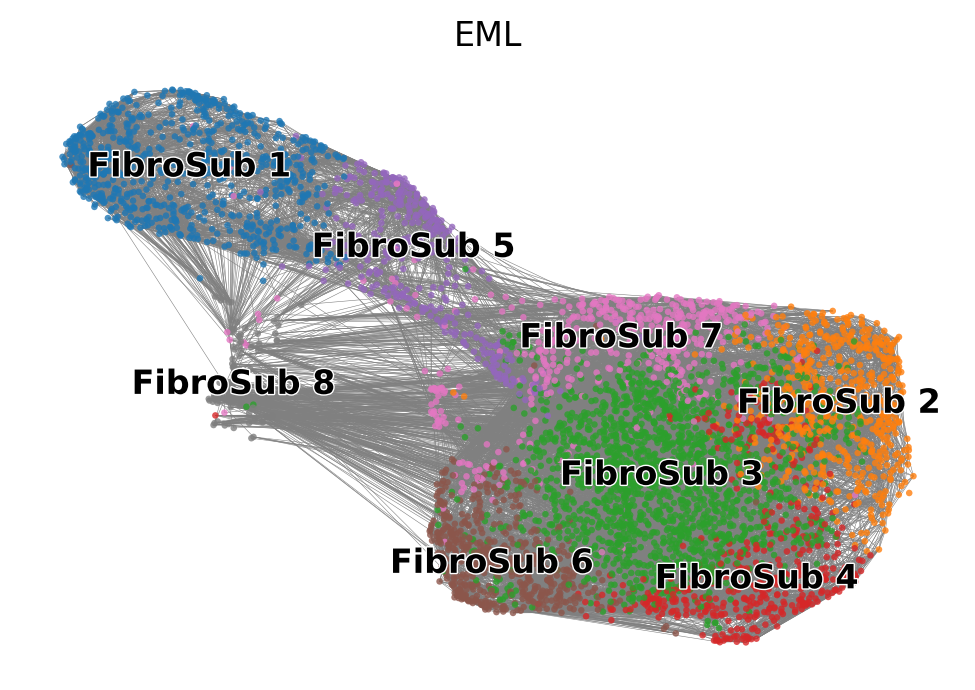

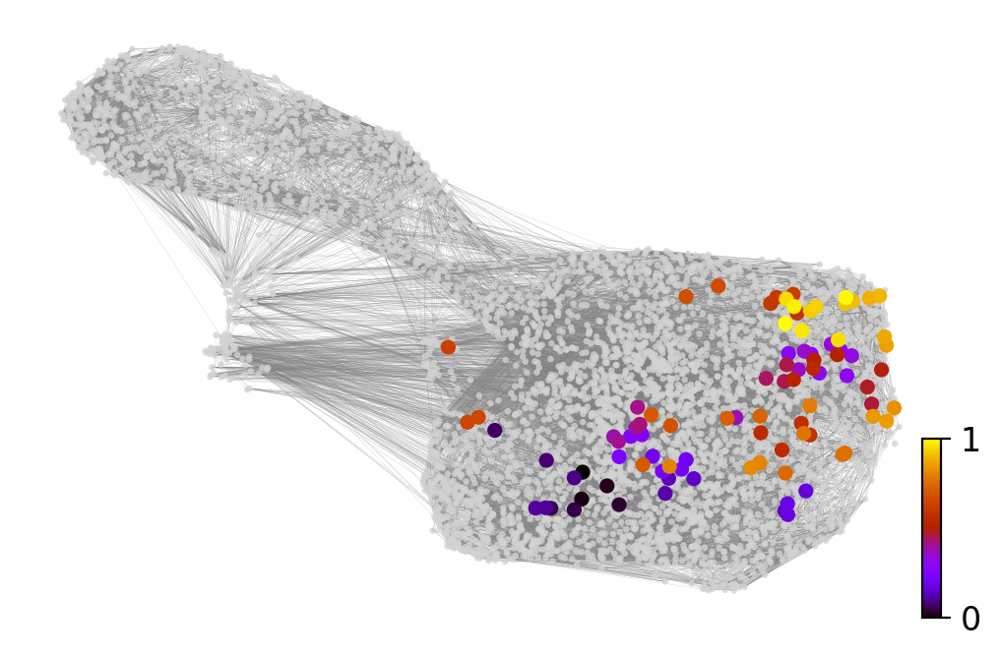

In [25]:
adata.uns['neighbors']['distances'] = adata.obsp['distances']
adata.uns['neighbors']['connectivities'] = adata.obsp['connectivities']

scv.tl.paga(adata, groups='EML')
scv.pl.paga(adata, basis='umap', size=50, alpha=.1,min_edge_width=2, node_size_scale=1.5)
df = scv.get_df(adata, 'paga/transitions_confidence', precision=2).T
df.style.background_gradient(cmap='Blues').format('{:.2g}')


running PAGA using priors: ['velocity_pseudotime']
    finished (0:00:01) --> added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns)
    'paga/transitions_confidence', velocity transitions (adata.uns)


,FibroSub_1,FibroSub_2,FibroSub_3,FibroSub_4,FibroSub_5,FibroSub_6,FibroSub_7,FibroSub_8
FibroSub_1,0,0,0,0,0.28,0,0,0
FibroSub_2,0,0,0,0,0,0,0,0
FibroSub_3,0,0.11,0,0,0,0,0,0
FibroSub_4,0,0,0,0,0,0,0,0
FibroSub_5,0,0,0.17,0,0,0,0,0
FibroSub_6,0,0,0.61,0.37,0,0,0.35,0.083
FibroSub_7,0,0,0,0,0,0,0,0
FibroSub_8,0,0,0,0,0,0,0,0


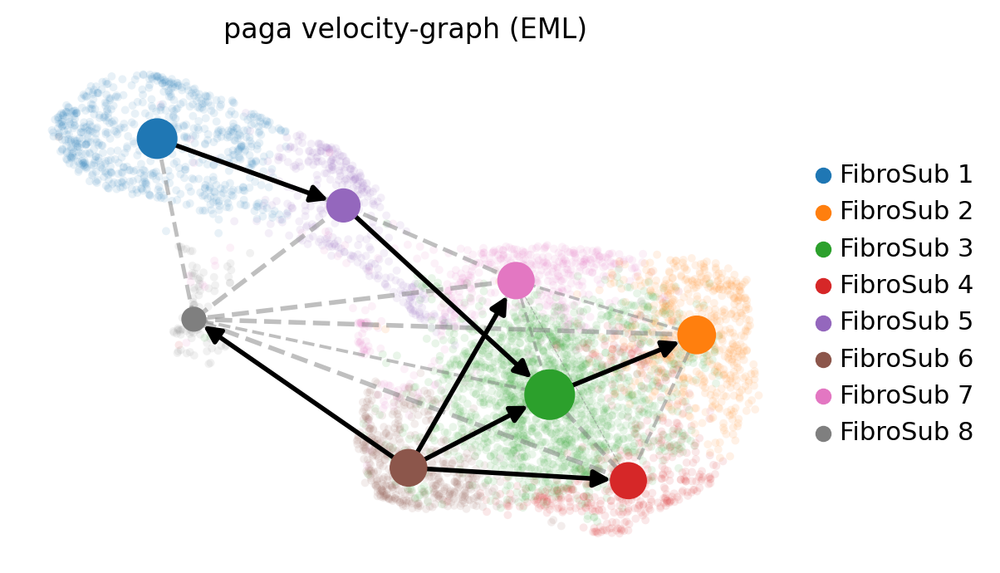

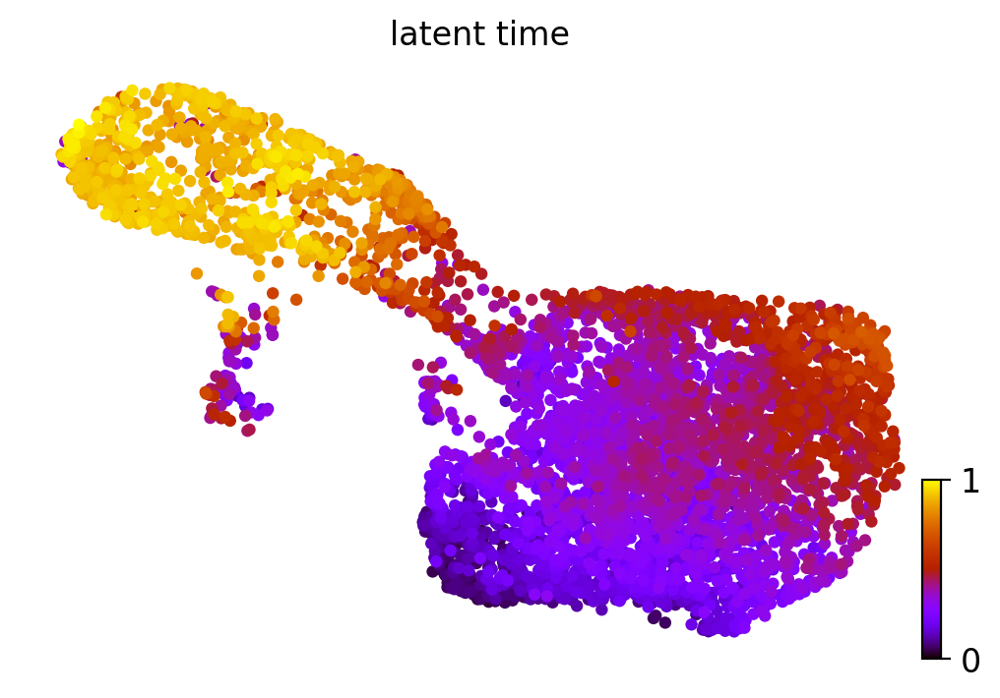

In [27]:
scv.pl.scatter(adata, color='latent_time', color_map='gnuplot', size=80)
